<center>

# Trabajo Práctico 3: REGISTRACIÓN DE IMÁGENES

## Procesamiento Avanzado de Imágenes en Biomedicina y Biología

### Segundo Cuatrimestre 2024

<table>
      <tr>
        <th>Alumnos</th>
        <th>Legajos</th>
      </tr>
      <tr>
        <td>
          Bajlec, Ivo<br>
          Grau, Gonzalo Andrés<br>
          Neira, Lucas Matias
        </td>
        <td>
          62175<br>
          62259<br>
          61750<br>
        </td>
      </tr>
    </table>

**Docente**: Roberto Sebastián Tomás

**Fecha de entrega**: 28/10/2024

</center>

In [1]:
import fft_analysis as ffta

from registration import Imagen
from registration import Registracion
from registration import lista_de_paths
from registration import agrupar_paths

%load_ext autoreload
%autoreload 2
%matplotlib inline

### 1- Registre las imágenes contenidas en las carpetas PAIByB-5 y PAIByB-6

#### I. Realice una registración basada en características evaluando los resultados con las métricas de la GUIA I de la imágenes contenidas en “PAIByB-5”¿Qué conclusiones puede sacar al respecto? 

##### Guardo las imagenes 

In [2]:
#extrigo paths 
lista_paths = lista_de_paths('PAIByB-5')
# Agrupar los paths
un_digito, dos_digitos = agrupar_paths(lista_paths)
#aplico la clase Imagen, esta me lee la imagen y calcula los puntos calve 
un_digito_imgs = [Imagen(image, feature_extractor='sift') for image in un_digito ]
dos_digito_imgs = [Imagen(image, feature_extractor='sift') for image in dos_digitos ]

#### Registración para imágenes del primer grupo


Registrando imagen 2 con la imagen de referencia
Matches encontrados: 52


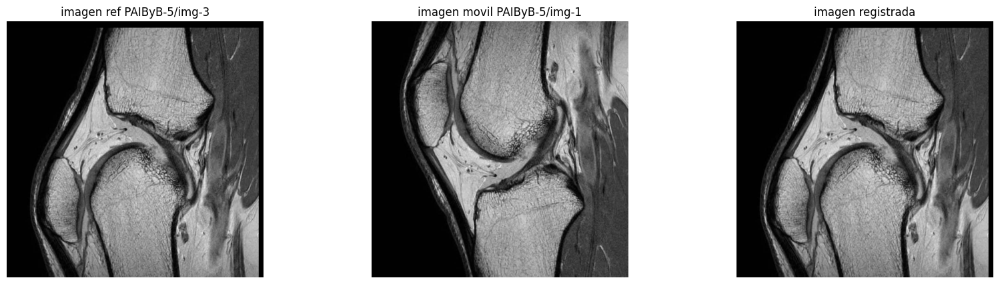

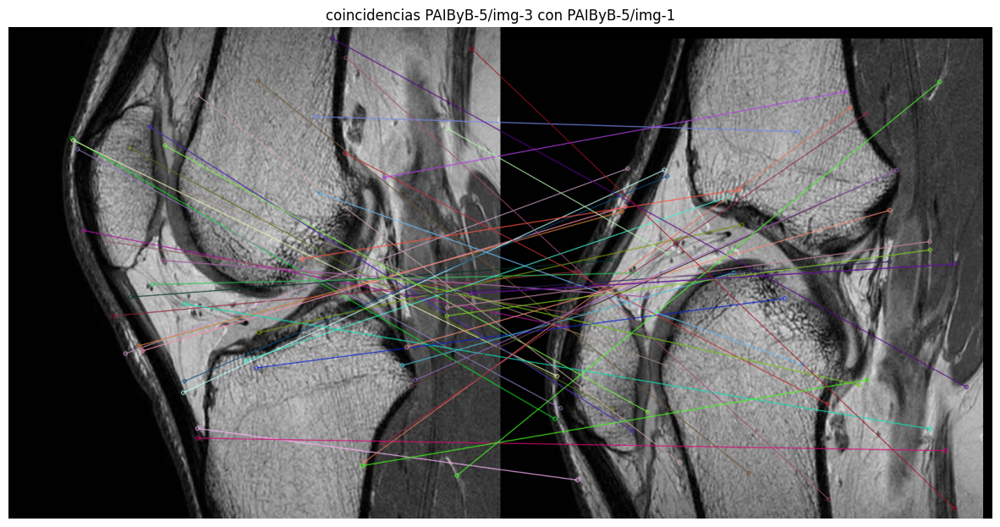

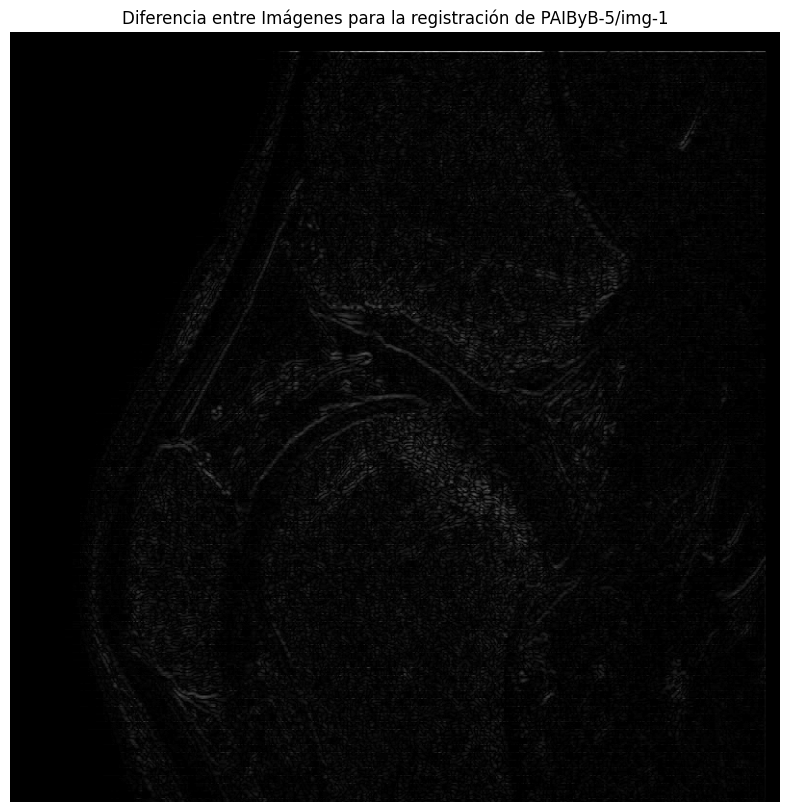

SSIM: 0.9808
MSE: 8.1109
PSNR: 89.8932

Registrando imagen 3 con la imagen de referencia
Matches encontrados: 42


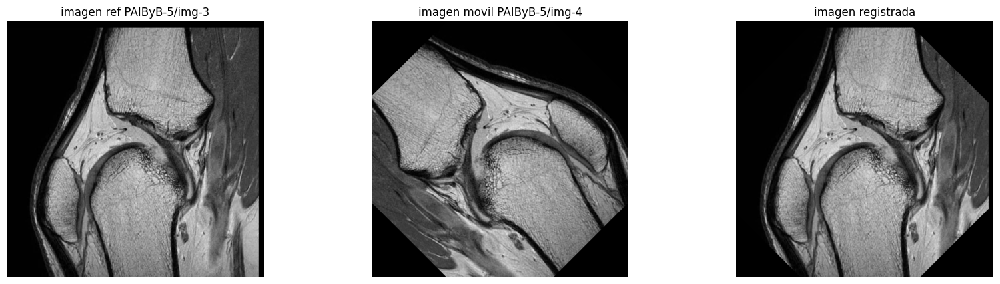

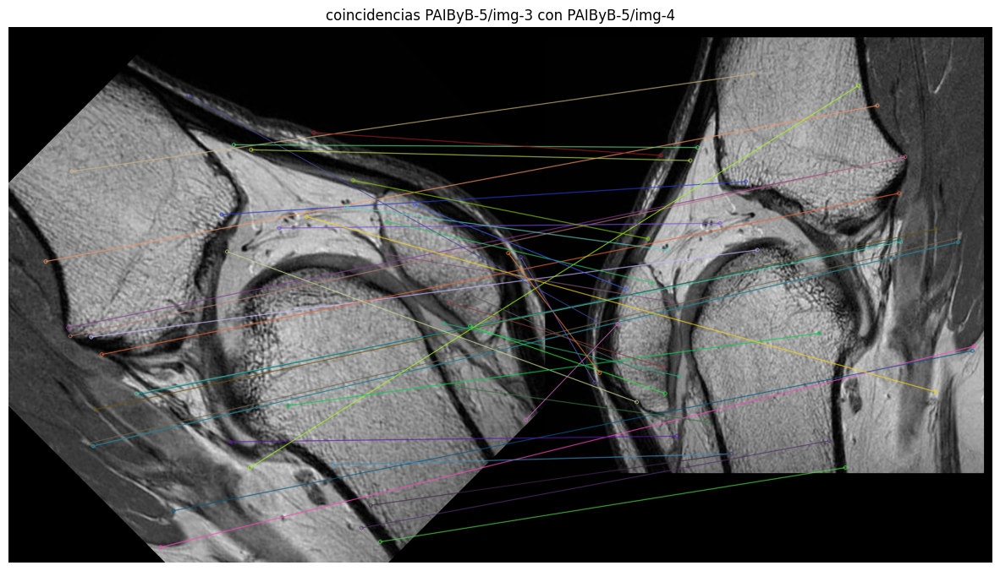

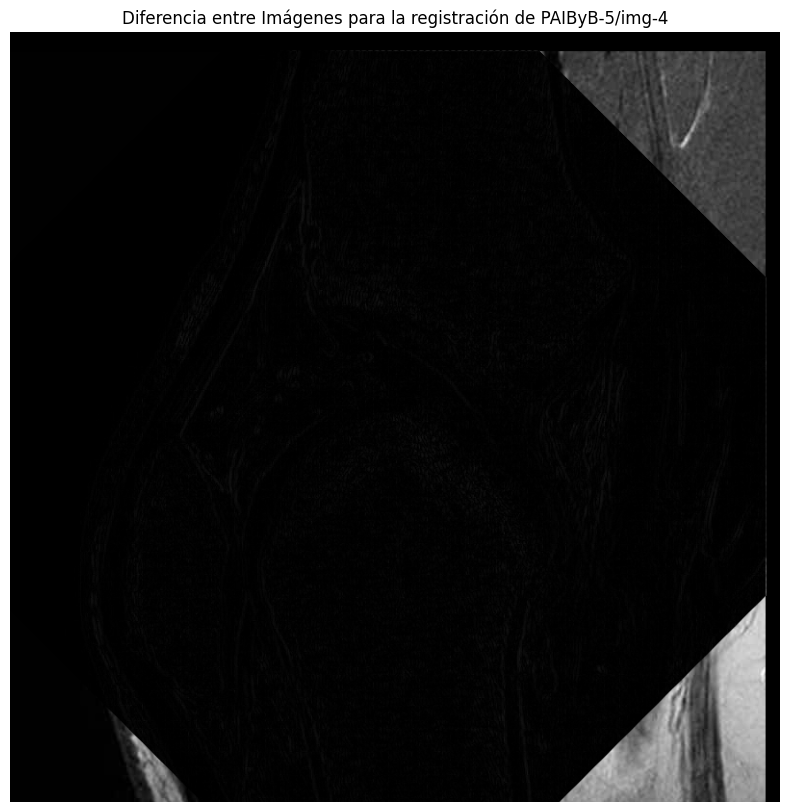

SSIM: 0.8883
MSE: 14.7393
PSNR: 83.9201

Registrando imagen 4 con la imagen de referencia
Matches encontrados: 40


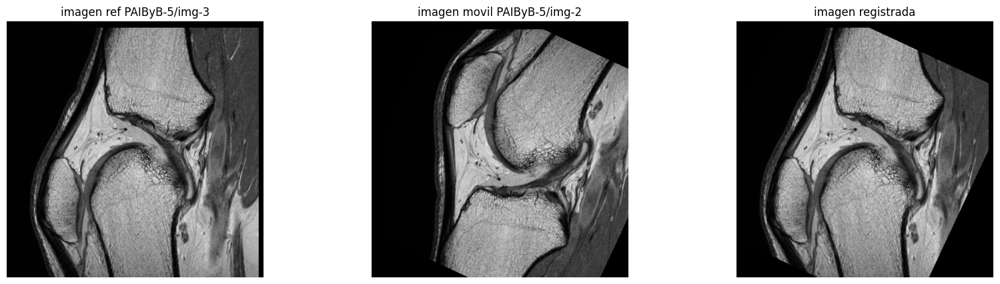

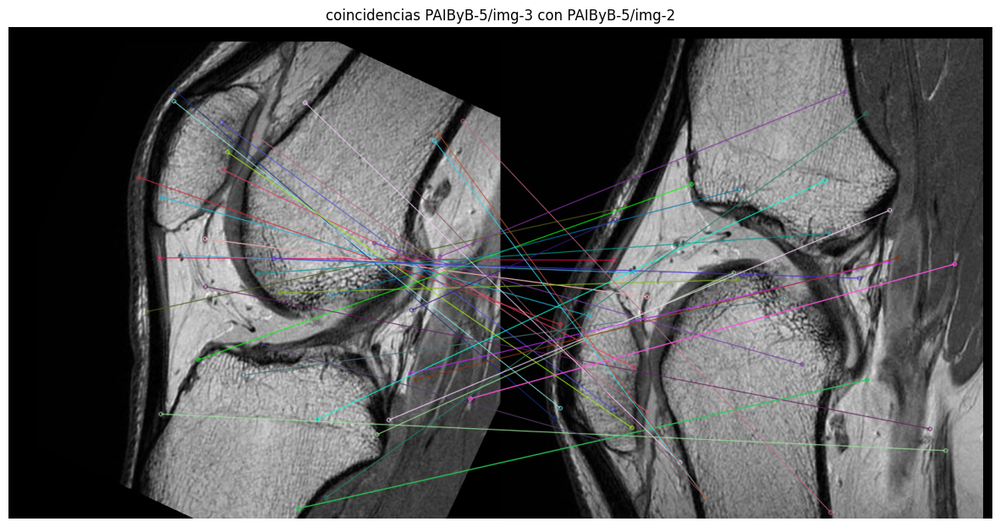

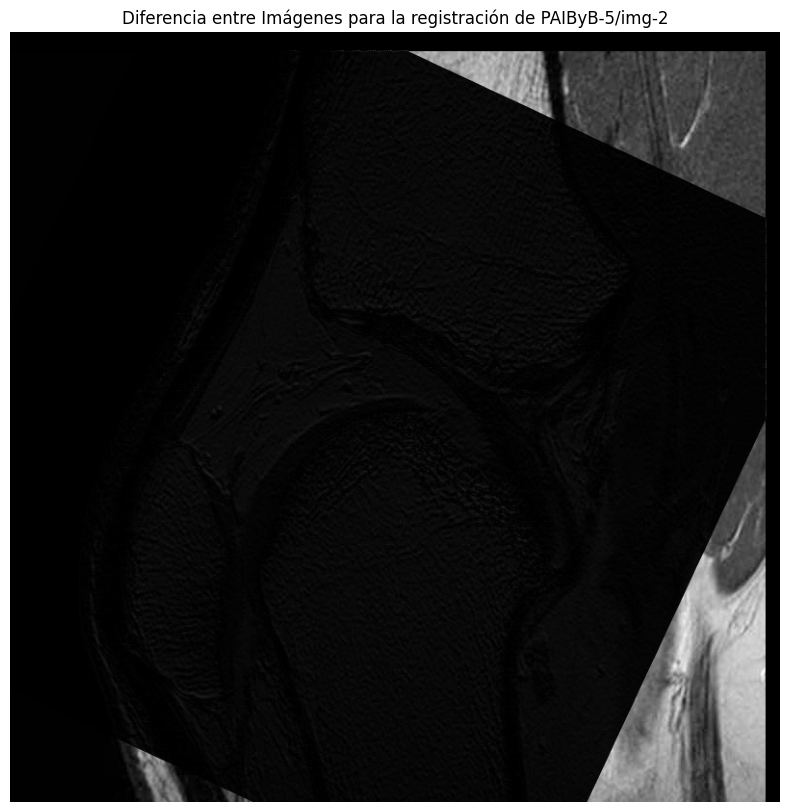

SSIM: 0.8566
MSE: 40.2093
PSNR: 73.8843


In [5]:
for i in range(1,len(un_digito)):
    # Crea una instancia de Registracion
    print('\n' + 80*'=')
    print(f"Registrando imagen {i+1} con la imagen de referencia")
    prueba = Registracion(imagen_referencia=un_digito_imgs[0], imagen_movil=un_digito_imgs[i])
    prueba.ejecutar_registracion()

#### Registración para imagenes del segundo grupo


Registrando imagen 2 con la imagen de referencia
Matches encontrados: 2045


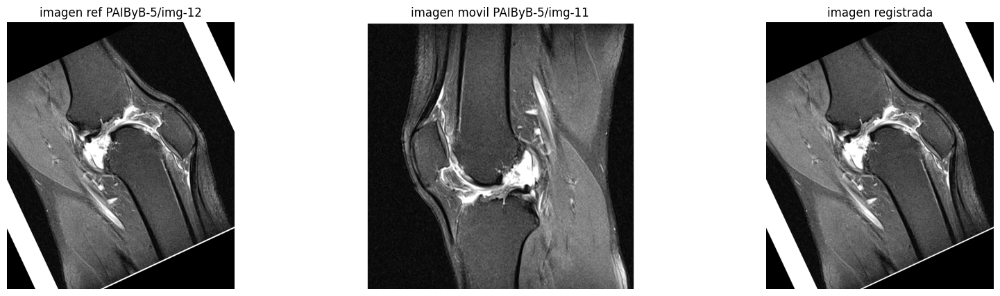

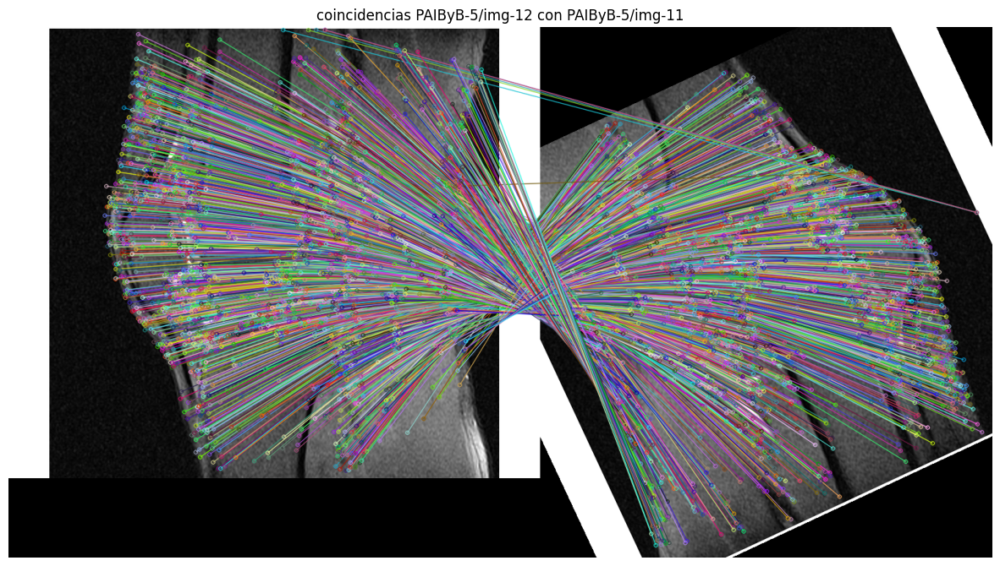

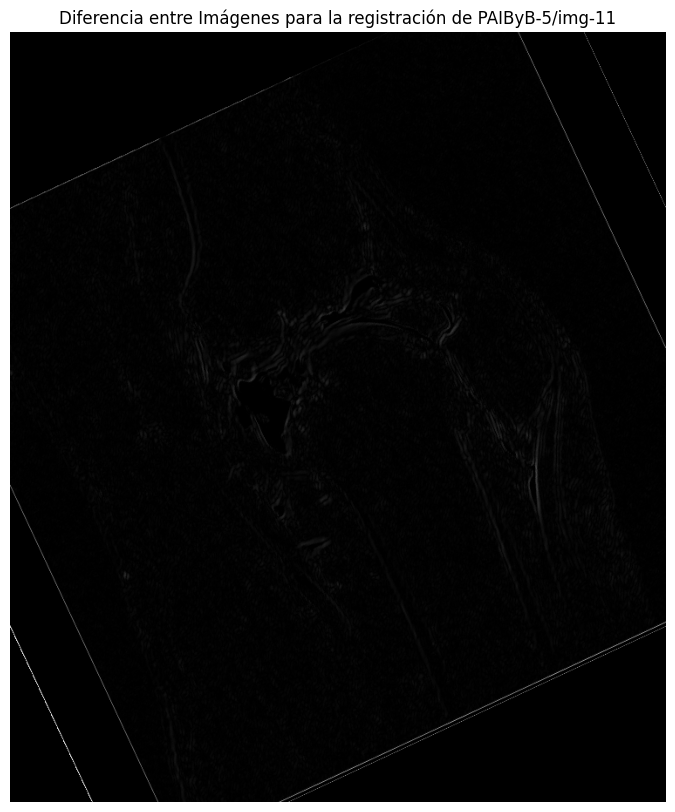

SSIM: 0.9592
MSE: 10.8056
PSNR: 87.0246


In [6]:
for i in range(1,len(dos_digito_imgs)):
    print('\n' + 80*'=')
    print(f"Registrando imagen {i+1} con la imagen de referencia")
    # Crea una instancia de Registracion
    prueba = Registracion(imagen_referencia=dos_digito_imgs[0], imagen_movil=dos_digito_imgs[i])
    prueba.ejecutar_registracion()

#### II. Realice una registración basada en características evaluando los resultados con las métricas de la GUIA I de la imagenes contenidas en “PAIByB-6”¿Qué conclusiones puede sacar al respecto? 

##### Guardo las imagenes

In [8]:
#extrigo paths 
lista_paths2 = lista_de_paths('PAIByB-6')
# Agrupar los paths
un_digito2, dos_digitos2 = agrupar_paths(lista_paths2)
#aplico la clase Imagen, esta me lee la imagen y calcula los puntos calve 
un_digito_imgs2 = [Imagen(image) for image in un_digito2 ]
dos_digito_imgs2 = [Imagen(image) for image in dos_digitos2 ]

##### Registracion para el primer grupo 


Registrando imagen 2 con la imagen de referencia
Matches encontrados: 133


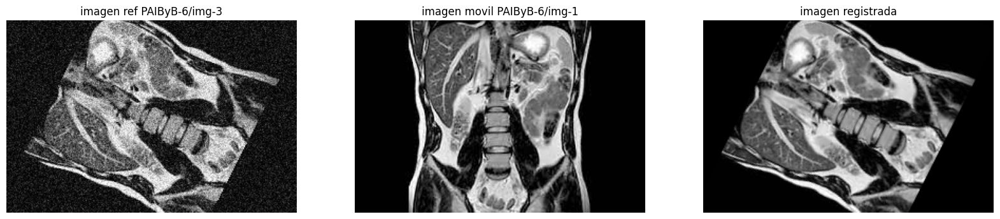

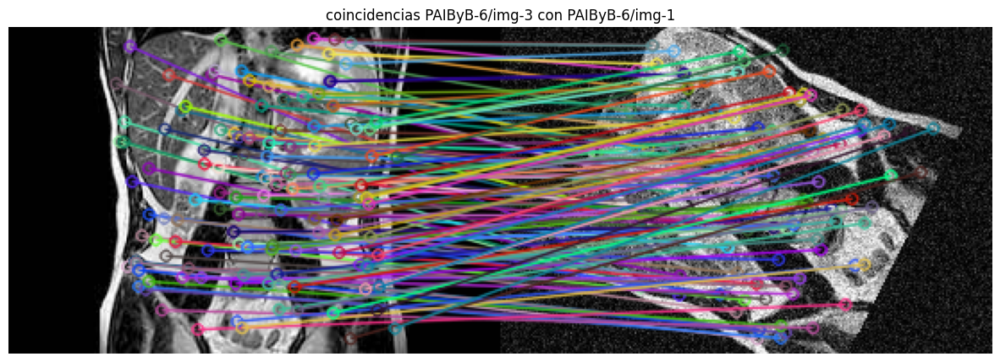

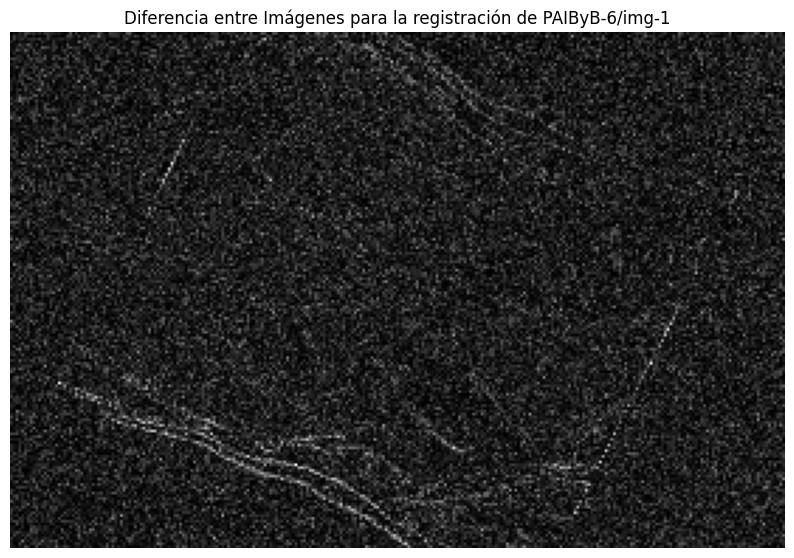

SSIM: 0.4285
MSE: 92.8367
PSNR: 65.5168

Registrando imagen 3 con la imagen de referencia
Matches encontrados: 18


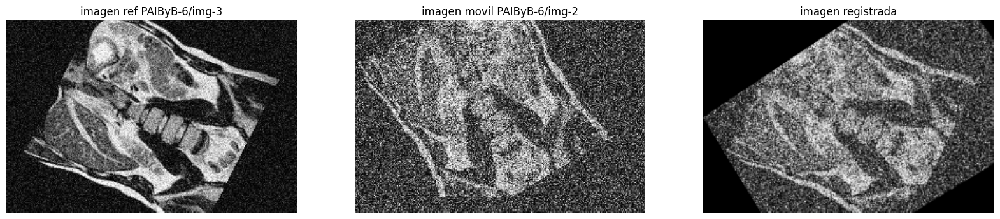

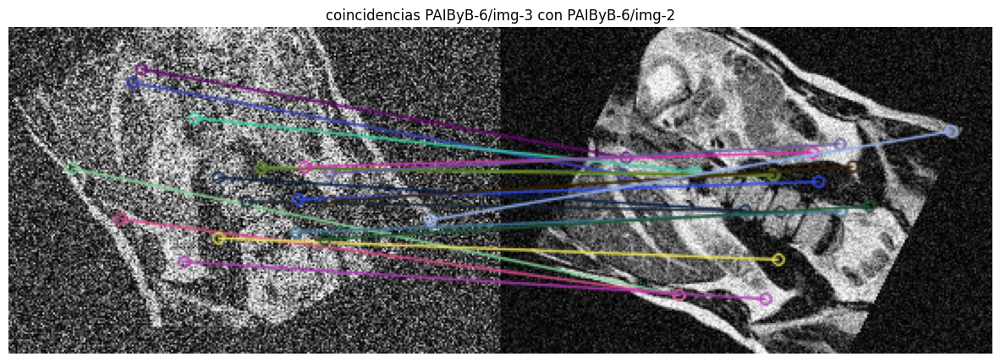

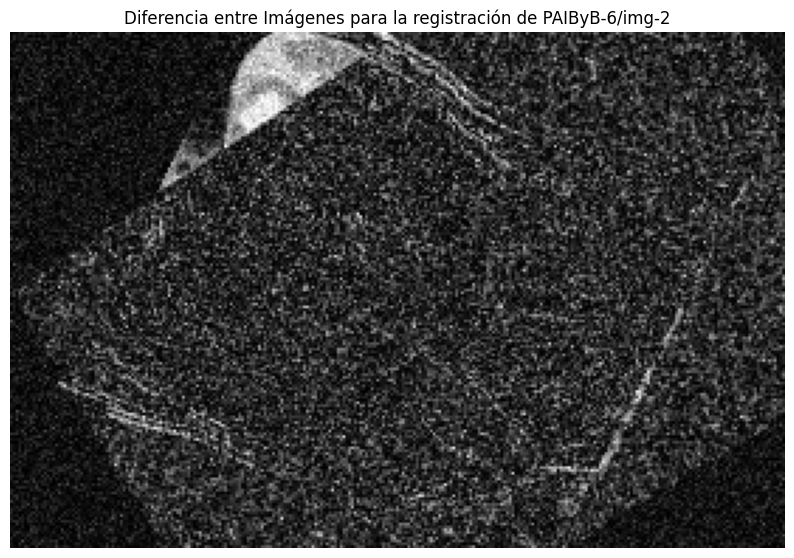

SSIM: 0.1412
MSE: 102.4600
PSNR: 64.5305


In [9]:
for i in range(1,len(un_digito2)):
    print('\n' + 80*'=')
    print(f"Registrando imagen {i+1} con la imagen de referencia")
    # Crea una instancia de Registracion
    prueba = Registracion(imagen_referencia=un_digito_imgs2[0], imagen_movil=un_digito_imgs2[i])
    prueba.ejecutar_registracion()

##### Registracion para el segundo grupo 


Registrando imagen 2 con la imagen de referencia
Matches encontrados: 85


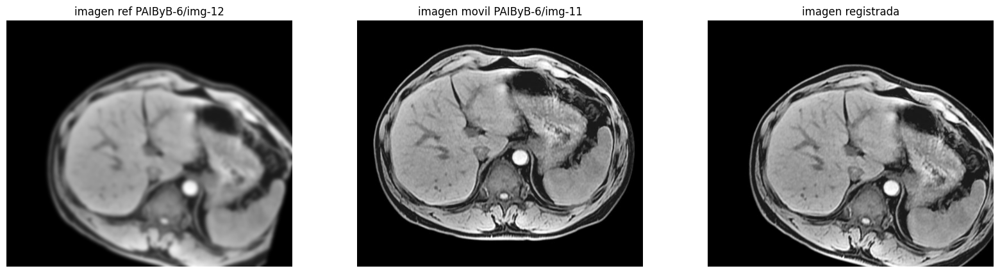

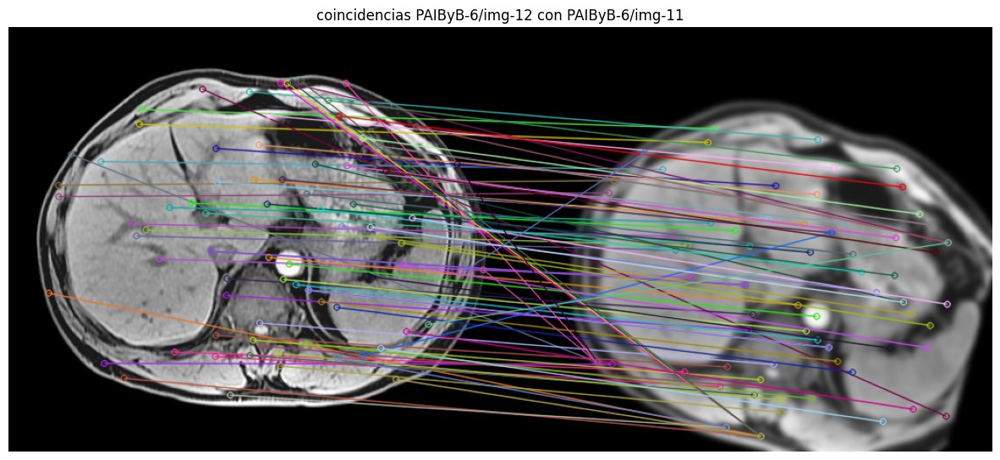

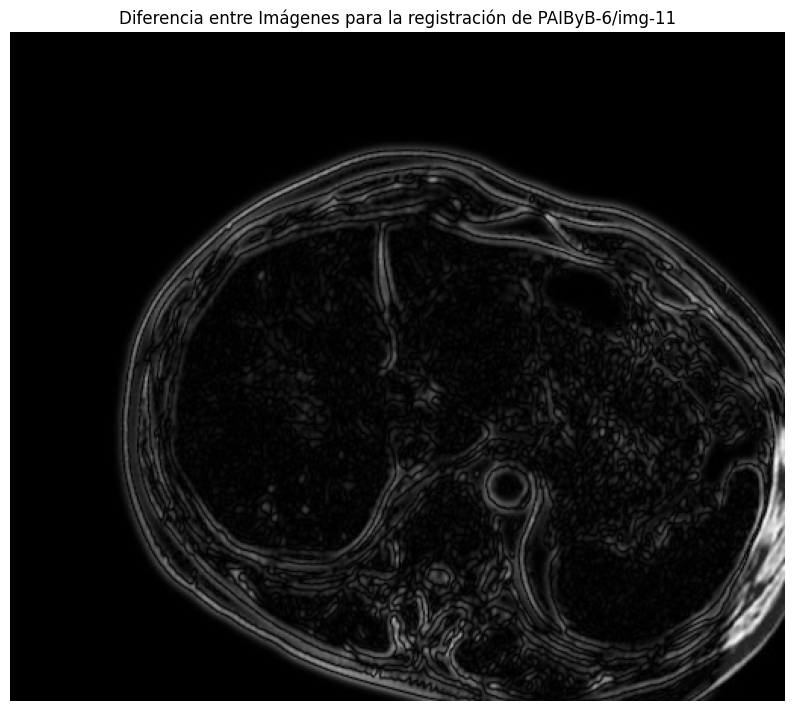

SSIM: 0.7590
MSE: 41.2720
PSNR: 73.6234


In [10]:
for i in range(1,len(dos_digitos2)):
    print('\n' + 80*'=')
    print(f"Registrando imagen {i+1} con la imagen de referencia")
    # Crea una instancia de Registracion
    prueba = Registracion(imagen_referencia=dos_digito_imgs2[0], imagen_movil=dos_digito_imgs2[i])
    prueba.ejecutar_registracion()

#### III. Realice una registración basada en características evaluando los resultados con las métricas de la GUIA I de la imagenes contenidas en “PAIByB-6” previamente pre-procesadas de la manera que crea conveniente ¿Qué conclusiones puede sacar al respecto? 

##### Denoising 

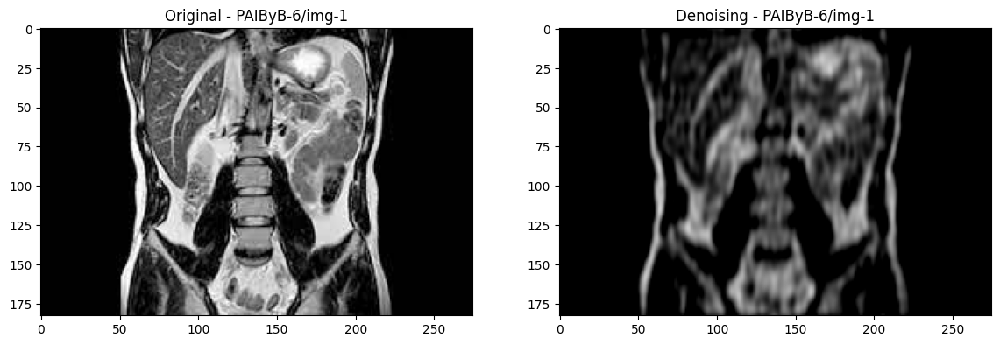

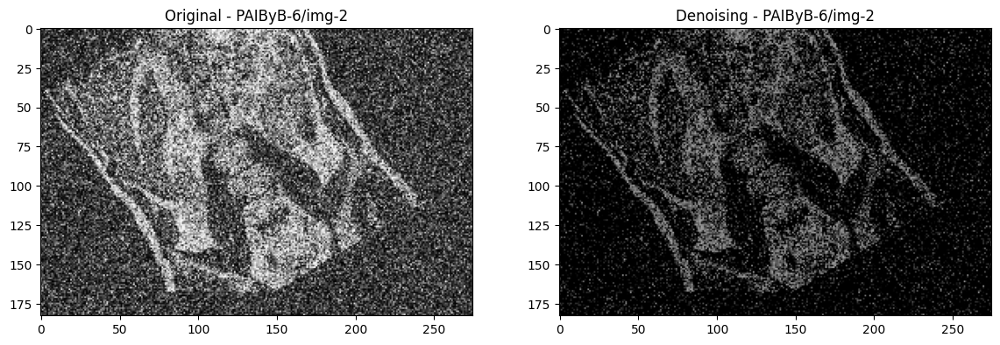

In [11]:
ths_img_2 = [89,125]
ths_img_3 = [70,125]


ths_list = [ths_img_2,ths_img_3]

filtered_imgs = []

for i in range(1, len(un_digito_imgs2) ):
    rec_img = ffta.cr8FFTDenoisingPlots(un_digito_imgs2[i].imagen,thresh_list= ths_list[i-1],name= un_digito_imgs2[i].nombre)
    filtered_imgs.append(rec_img)

#filtered_n_equ_imgs = np.array([cv2.equalizeHist(img) for img in filtered_imgs])

##### Registracion 

In [12]:
for i in range(1,len(un_digito2)):
    un_digito_imgs2[i].imagen = filtered_imgs[i-1]


Registrando imagen 2 con la imagen de referencia
Matches encontrados: 133


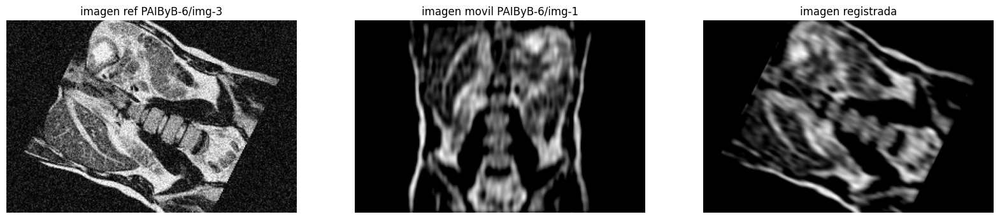

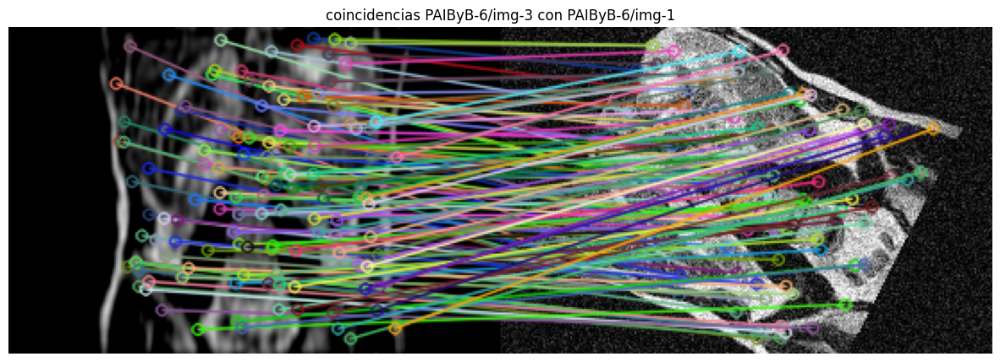

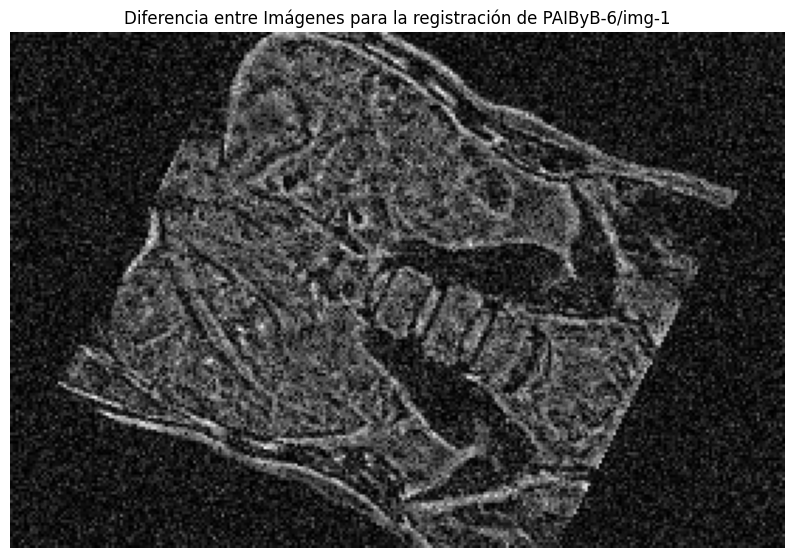

SSIM: 0.1803
MSE: 101.0421
PSNR: 64.6699

Registrando imagen 3 con la imagen de referencia
Matches encontrados: 18


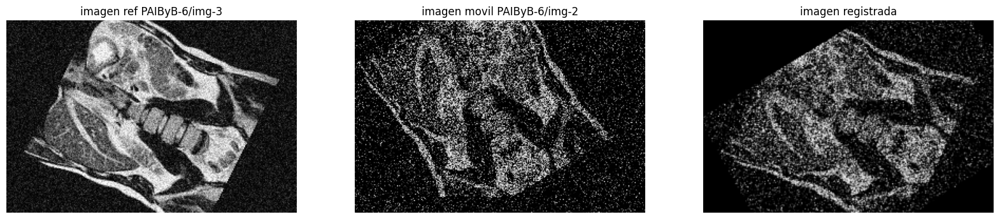

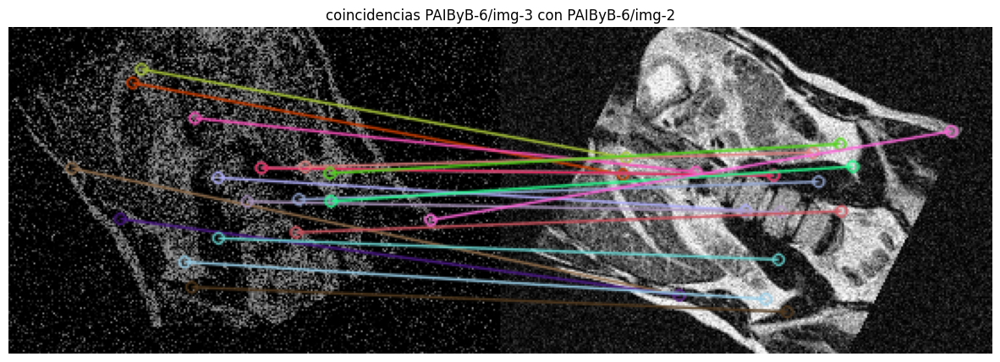

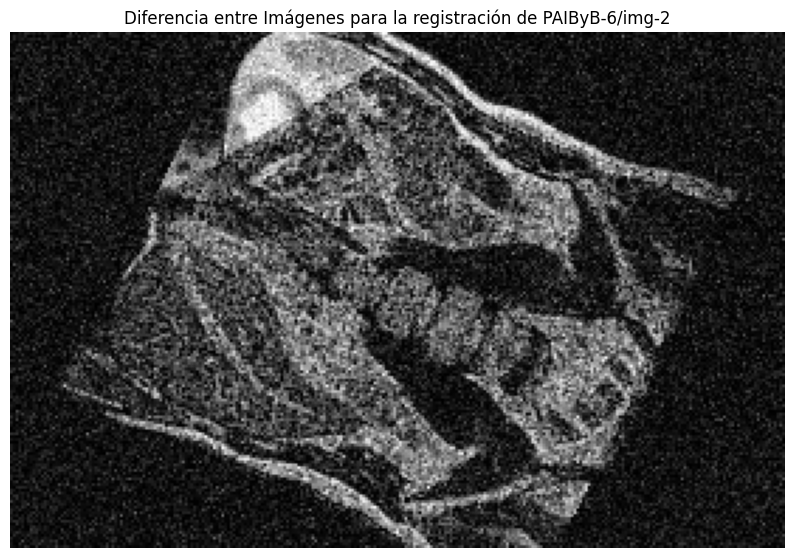

SSIM: 0.1005
MSE: 97.5264
PSNR: 65.0240


In [13]:
for i in range(1,len(un_digito2)):
    print('\n' + 80*'=')
    print(f"Registrando imagen {i+1} con la imagen de referencia")
    # Crea una instancia de Registracion
    prueba = Registracion(imagen_referencia=un_digito_imgs2[0], imagen_movil=un_digito_imgs2[i])
    prueba.ejecutar_registracion()


#### Registracion 

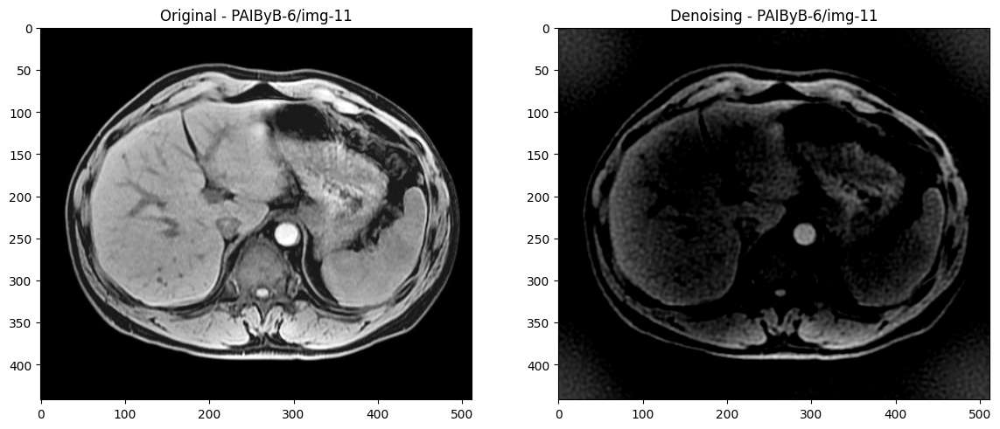

In [14]:
ths_img_4 = [89,125]


ths_list = [ths_img_4,]

filtered_imgs2 = []

for i in range(1, len(dos_digito_imgs2) ):
    rec_img = ffta.cr8FFTDenoisingPlots(dos_digito_imgs2[i].imagen,thresh_list= ths_list[i-1],name= dos_digito_imgs2[i].nombre)
    filtered_imgs2.append(rec_img)

In [15]:
dos_digito_imgs2[1].imagen = filtered_imgs2[0]



Registrando imagen 2 con la imagen de referencia
Matches encontrados: 81


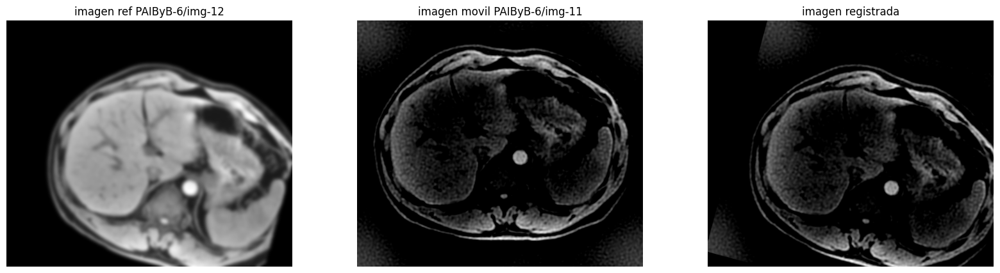

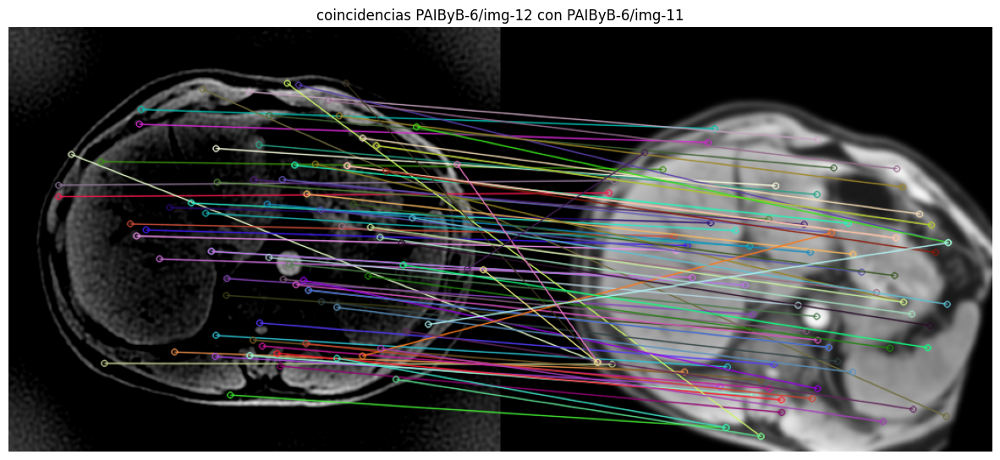

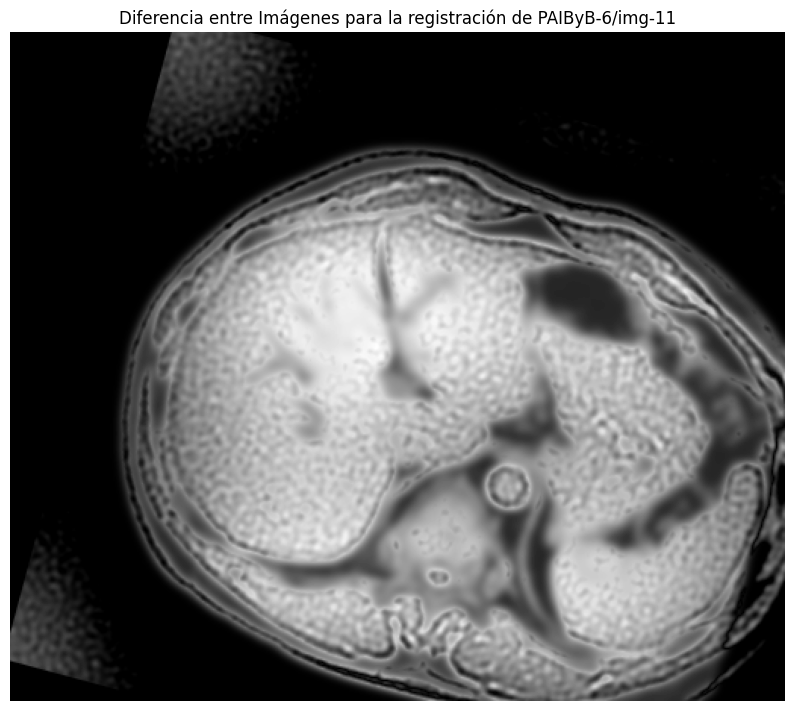

SSIM: 0.4555
MSE: 64.4273
PSNR: 69.1699


In [16]:
for i in range(1,len(dos_digito_imgs2)):
    print('\n' + 80*'=')
    print(f"Registrando imagen {i+1} con la imagen de referencia")
    # Crea una instancia de Registracion
    prueba = Registracion(imagen_referencia=dos_digito_imgs2[0], imagen_movil=dos_digito_imgs2[i])
    prueba.ejecutar_registracion()

1) Se puede apreciar de manera visual y objetiva, mediante las métricas, cómo para las imágenes de PAIByB-5 se realiza una reconstrucción casi perfecta. Las diferencias se observan solo en detalles de baja frecuencia, que aparecen como una ligera difuminación en la diferencia absoluta entre imágenes. Además, destaca la pérdida irrecuperable de información en la imagen móvil, que limita la reconstrucción en ciertas porciones.

2) A pesar del ruido presente en las imágenes de PAIByB-6 sin filtrar previamente, se observa que el algoritmo es lo suficientemente robusto como para realizar la registración a través del ruido.

3) Dado que ya se obtenían buenos resultados sin filtrar el ruido, la mejora al aplicar un denoising previo no es significativa.

## 2- Registre las imágenes contenidas en las carpetas y compara los resultados con el ejercicio anterior:
IV. Realice una registración usando el algoritmo CCN evaluando los resultados con las métricas
de la GUIA I de la imagenes contenidas en “PAIByB-5”¿Qué conclusiones puede sacar al
respecto?

V. Realice una registración usando el algoritmo CCN evaluando los resultados con las métricas
de la GUIA I de la imagenes contenidas en “PAIByB-6”¿Qué conclusiones puede sacar al
respecto?

VI. Realice una registración usando el algoritmo CCN evaluando los resultados con las métricas
de la GUIA I dde la imagenes contenidas en “PAIByB-6” previamente pre-procesadas de la
manera que crea conveniente ¿Qué conclusiones puede sacar al respecto?
Compara los resultados obtenidos con los del ejercicio anterior: ¿Que conclusiones puede sacar,
cual es el tipo de registración mas afectada por la calidad de la imagen

### Lectura de archivos y visualización de imágenes

In [2]:
import fft_analysis as ffta
from reg_toolkit import *

In [3]:
%load_ext autoreload
%autoreload 2

In [3]:
dict_folder_paibyb5 = getPathfiles('PAIByB-5')
dict_folder_paibyb6 = getPathfiles('PAIByB-6')

print(dict_folder_paibyb5)
print(dict_folder_paibyb6)

dict_folder_paibyb5_values = [*dict_folder_paibyb5.values()]
dict_folder_paibyb6_values = [*dict_folder_paibyb6.values()]

imgs_folder_paibyb5 = getImagesFromPathfile(dict_folder_paibyb5_values)
imgs_folder_paibyb6 = getImagesFromPathfile(dict_folder_paibyb6_values)


{'img-1.tif': 'PAIByB-5/img-1.tif', 'img-2.tif': 'PAIByB-5/img-2.tif', 'img-3.tif': 'PAIByB-5/img-3.tif', 'img-4.tif': 'PAIByB-5/img-4.tif', 'img-11.tif': 'PAIByB-5/img-11.tif', 'img-12.tif': 'PAIByB-5/img-12.tif'}
{'img-1.tif': 'PAIByB-6/img-1.tif', 'img-2.tif': 'PAIByB-6/img-2.tif', 'img-3.tif': 'PAIByB-6/img-3.tif', 'img-11.tif': 'PAIByB-6/img-11.tif', 'img-12.tif': 'PAIByB-6/img-12.tif'}


In [4]:
values_paibyb5_group1   = dict_folder_paibyb5_values[:-2]
imgs_paibyb5_group1     = imgs_folder_paibyb5[:-2]

print(values_paibyb5_group1)

values_paibyb5_group2   = dict_folder_paibyb5_values[-2:]
imgs_paibyb5_group2     = imgs_folder_paibyb5[-2:]

print(values_paibyb5_group2)

['PAIByB-5/img-1.tif', 'PAIByB-5/img-2.tif', 'PAIByB-5/img-3.tif', 'PAIByB-5/img-4.tif']
['PAIByB-5/img-11.tif', 'PAIByB-5/img-12.tif']


In [5]:
values_paibyb6_group1   = dict_folder_paibyb6_values[:-2]
imgs_paibyb6_group1     = imgs_folder_paibyb6[:-2]

print(values_paibyb6_group1)

values_paibyb6_group2   = dict_folder_paibyb6_values[-2:]
imgs_paibyb6_group2     = imgs_folder_paibyb6[-2:]

print(values_paibyb6_group2)

['PAIByB-6/img-1.tif', 'PAIByB-6/img-2.tif', 'PAIByB-6/img-3.tif']
['PAIByB-6/img-11.tif', 'PAIByB-6/img-12.tif']


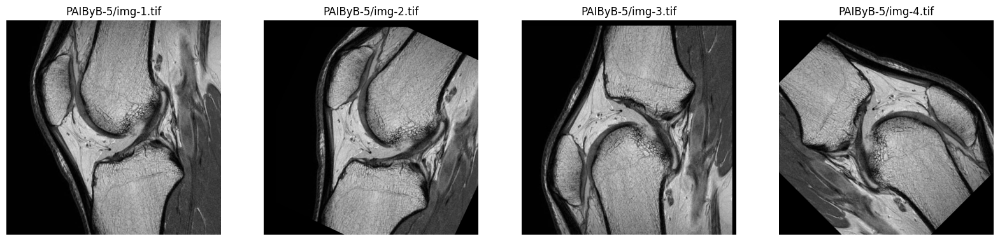

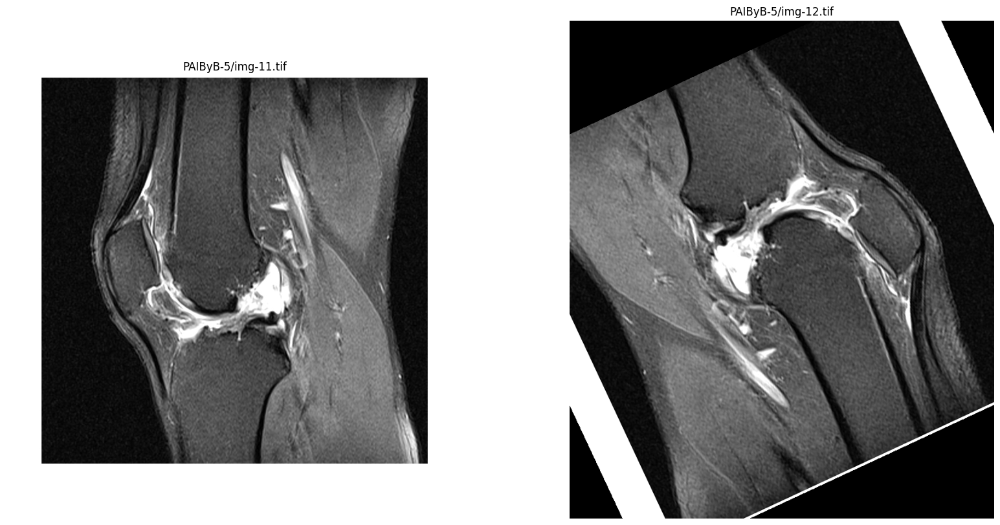

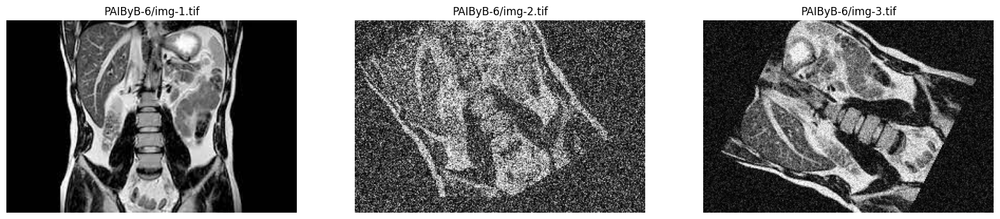

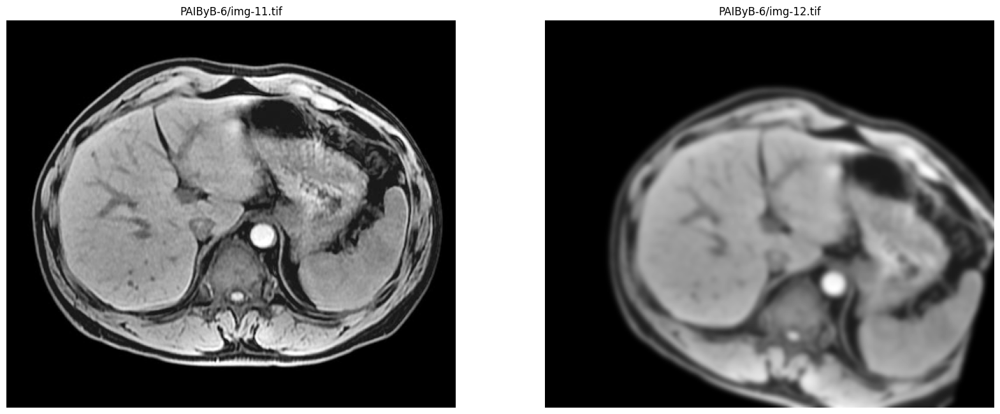

In [6]:
plotImgs(values_paibyb5_group1,imgs_paibyb5_group1)
plotImgs(values_paibyb5_group2,imgs_paibyb5_group2)
plotImgs(values_paibyb6_group1,imgs_paibyb6_group1)
plotImgs(values_paibyb6_group2,imgs_paibyb6_group2)

### Registración para el grupo 1 de imágenes de la carpeta PAIByB-5

Se lleva a cabo una reigstración basada principalmente en traslación y rotación utilizado CCN como parámetro para ajustar la posición de la imágen móvil con respecto a la imagen fija.

Todas las imágenes fueron registradas con éxito.

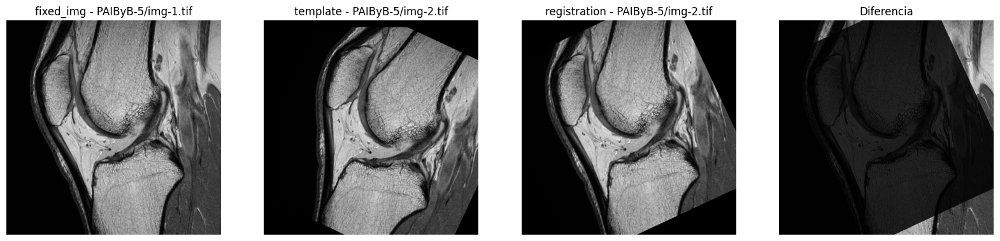

[np.int64(25), np.float64(0.9524941444396973)]


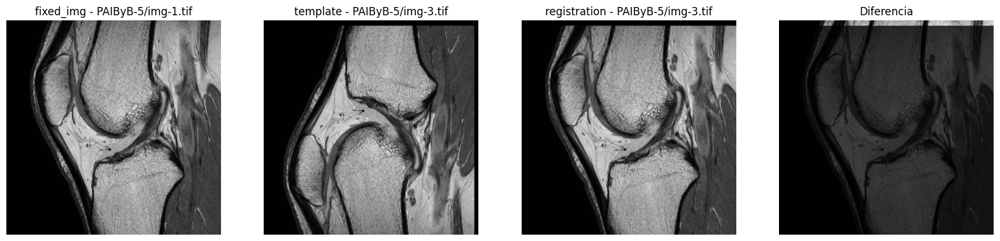

[0.9999999403953552]


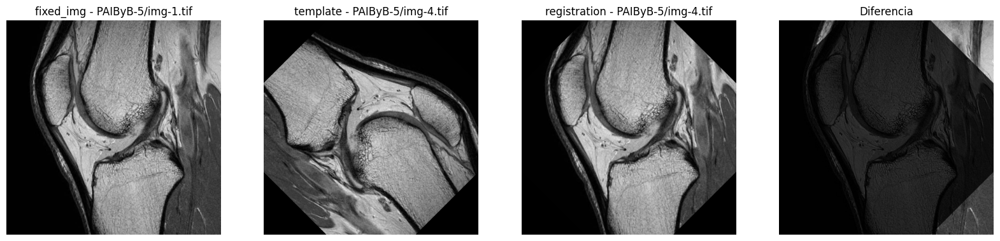

[np.int64(135), np.float64(0.9564709663391113)]


In [7]:
fixed_img_5g1 = imgs_paibyb5_group1[0]
reg_5g1_1, data_reg_5g1_1 = matchImg(fixed_img_5g1,imgs_paibyb5_group1[1],mode=1)
reg_5g1_2, data_reg_5g1_2 = matchImg(fixed_img_5g1,imgs_paibyb5_group1[2],mode=0,flip_template=True)
reg_5g1_3, data_reg_5g1_3 = matchImg(fixed_img_5g1,imgs_paibyb5_group1[3],mode=1,resize_template=True)

plotMatchComparison(fixed_img_5g1,imgs_paibyb5_group1[1],reg_5g1_1,fixed_img_name=values_paibyb5_group1[0],template_name=values_paibyb5_group1[1])
print(data_reg_5g1_1)
plotMatchComparison(fixed_img_5g1,imgs_paibyb5_group1[2],reg_5g1_2,fixed_img_name=values_paibyb5_group1[0],template_name=values_paibyb5_group1[2])
print(data_reg_5g1_2)
plotMatchComparison(fixed_img_5g1,imgs_paibyb5_group1[3],reg_5g1_3,fixed_img_name=values_paibyb5_group1[0],template_name=values_paibyb5_group1[3])
print(data_reg_5g1_3)

registration_imgs_5g1 = [reg_5g1_1,reg_5g1_2,reg_5g1_3]

### Registración para el grupo 2 de imágenes de la carpeta PAIByB-5

Se lleva a cabo una reigstración basada principalmente en traslación y rotación utilizado CCN como parámetro para ajustar la posición de la imágen móvil con respecto a la imagen fija.

Todas las imágenes fueron registradas con éxito.

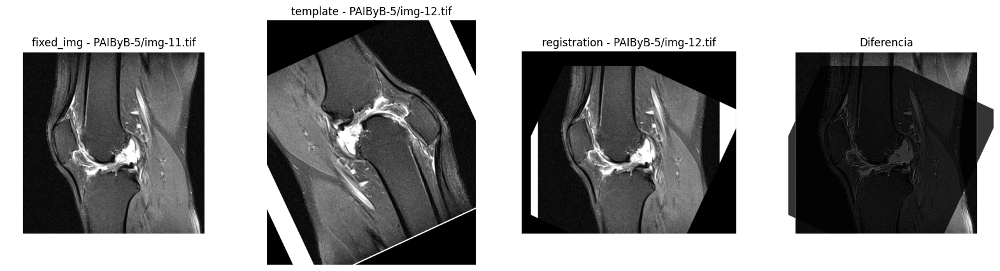

[np.int64(155), np.float64(0.9523078799247742)]


In [8]:
fixed_img_5g2 = imgs_paibyb5_group2[0]

reg_5g2_1, data_reg_5g2_1 = matchImg(fixed_img_5g2,imgs_paibyb5_group2[1],mode=1,cut_template=True)

plotMatchComparison(fixed_img_5g2,imgs_paibyb5_group2[1],reg_5g2_1,fixed_img_name=values_paibyb5_group2[0],template_name=values_paibyb5_group2[1])
print(data_reg_5g2_1)

registration_imgs_5g2 = [reg_5g2_1]

### Registración para el grupo 1 de imágenes de la carpeta PAIByB-6

Se lleva a cabo una reigstración basada principalmente en traslación y rotación utilizado CCN como parámetro para ajustar la posición de la imágen móvil con respecto a la imagen fija.

No hay procesamiento previo de las imágenes a registrar.

Solo el caso de la imagen 'img-2' puede ser registrada con éxtio.

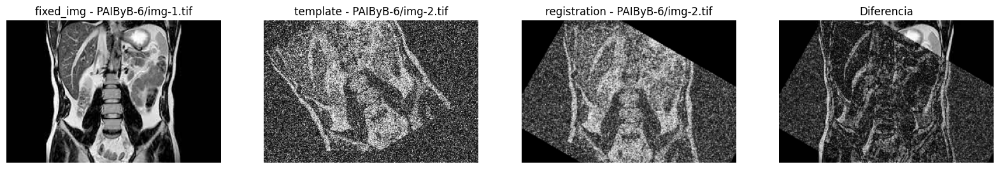

[np.int64(-30), np.float64(0.8062126040458679)]


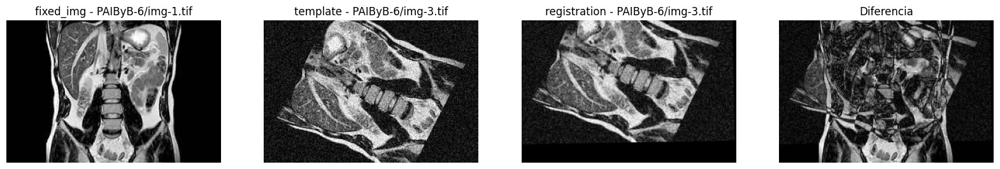

[np.int64(1), np.float64(0.7823050022125244)]


In [16]:
fixed_img_6g1 = imgs_paibyb6_group1[0]

reg_6g1_1, data_reg_6g1_1 = matchImg(fixed_img_6g1,imgs_paibyb6_group1[1],mode=1,counterclockwise=False)
reg_6g1_2, data_reg_6g1_2 = matchImg(fixed_img_6g1,imgs_paibyb6_group1[2],mode=1,a=0.2)

plotMatchComparison(fixed_img_6g1,imgs_paibyb6_group1[1],reg_6g1_1,fixed_img_name=values_paibyb6_group1[0],template_name=values_paibyb6_group1[1])
print(data_reg_6g1_1)
plotMatchComparison(fixed_img_6g1,imgs_paibyb6_group1[2],reg_6g1_2,fixed_img_name=values_paibyb6_group1[0],template_name=values_paibyb6_group1[2])
print(data_reg_6g1_2)

registration_imgs_6g1 = [reg_6g1_1,reg_6g1_2]

### Registración para el grupo 2 de imágenes de la carpeta PAIByB-6

Se lleva a cabo una reigstración basada principalmente en traslación y rotación utilizado CCN como parámetro para ajustar la posición de la imágen móvil con respecto a la imagen fija.

No hay procesamiento previo de las imágenes a registrar.

Todas las imágenes fueron registradas con éxito.

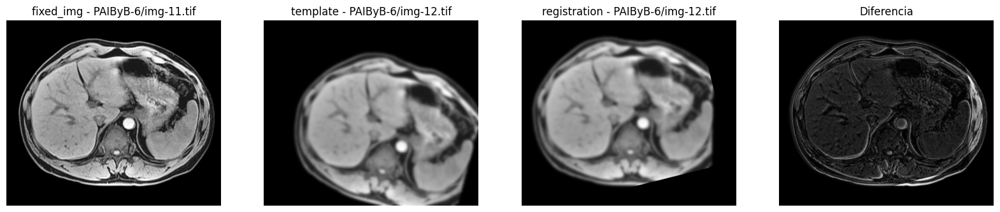

[np.int64(14), np.float64(0.9468894600868225)]


In [17]:
fixed_img_6g2 = imgs_paibyb6_group2[0]

reg_6g2_1, data_reg_6g2_1 = matchImg(fixed_img_6g2,imgs_paibyb6_group2[1],mode=1)

plotMatchComparison(fixed_img_6g2,imgs_paibyb6_group2[1],reg_6g2_1,fixed_img_name=values_paibyb6_group2[0],template_name=values_paibyb6_group2[1])
print(data_reg_6g2_1)

registration_imgs_6g2 = [reg_6g2_1]

### Pre-procesamiento de las imágenes móviles de la carpeta 'PAIByB-6'

#### Primer procesamiento

Para las imágenes del grupo 1, se utilizará la técnica de denoising a través del uso de la FFT aplicando máscaras con umbrales a la FFT de las imágenes móviles para eliminar gran aprte del ruido. Luego se aplicará una ecualización del histograma a las imágenes resultantes del paso anterior.

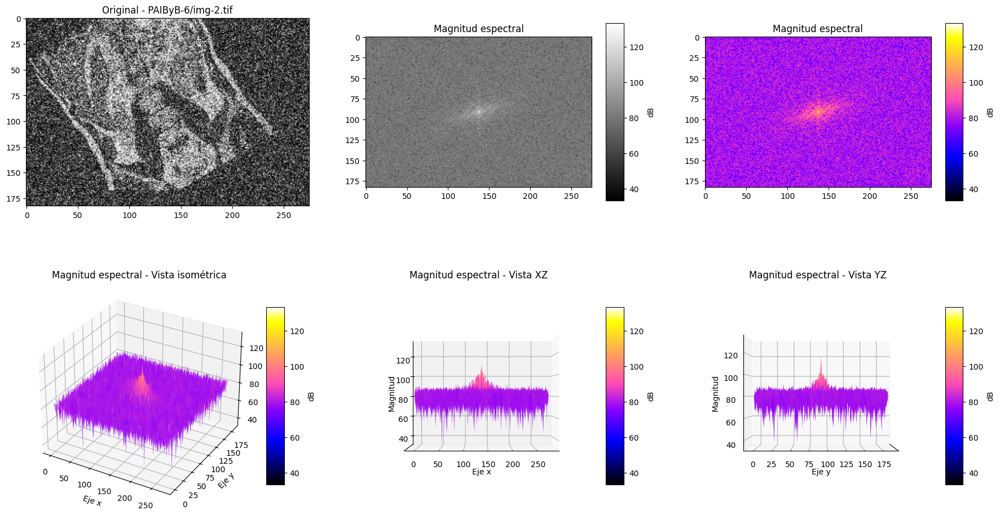

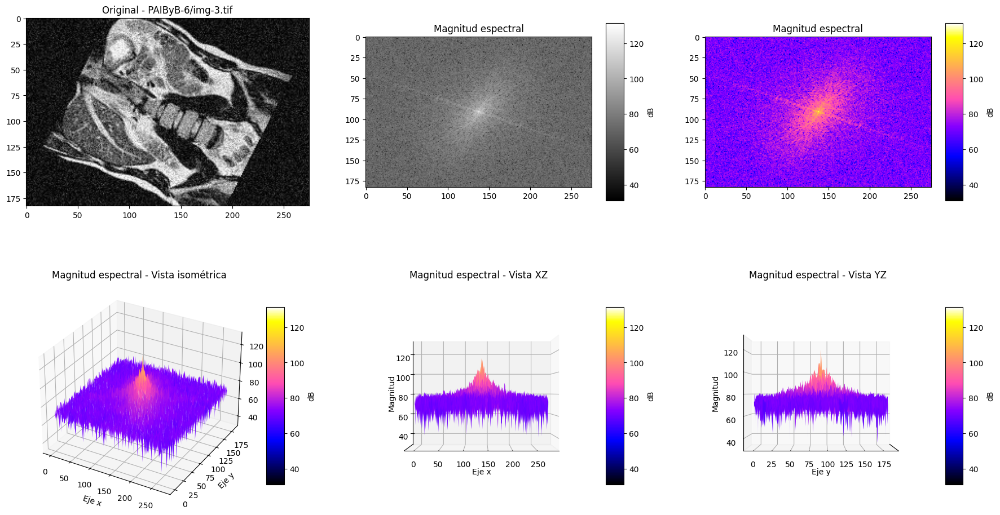

In [18]:
for i in range(1,len(imgs_paibyb6_group1)):
    fig = ffta.cr8FFTimgsPlots(imgs_paibyb6_group1[i],values_paibyb6_group1[i])


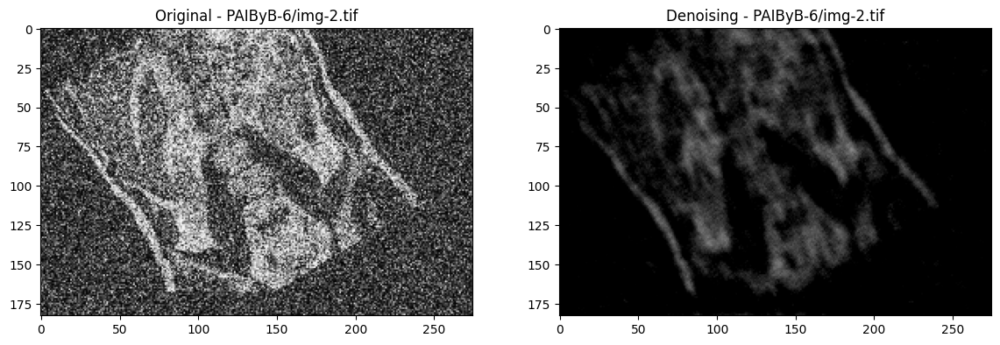

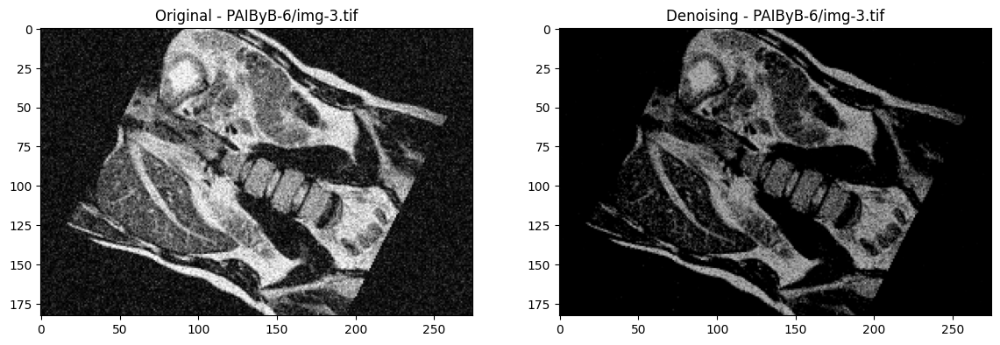

In [9]:
ths_img_2 = [89,125]
ths_img_3 = [70,125]

ths_list = [ths_img_2,ths_img_3]

filtered_imgs = []

for i in range(len(ths_list)):
    rec_img = ffta.cr8FFTDenoisingPlots(imgs_paibyb6_group1[1+i],ths_list[i],name=values_paibyb6_group1[1+i])
    filtered_imgs.append(rec_img)

#### Resultado del primer procesamiento

denoised_7/img-2.tif
denoised_7/img-3.tif


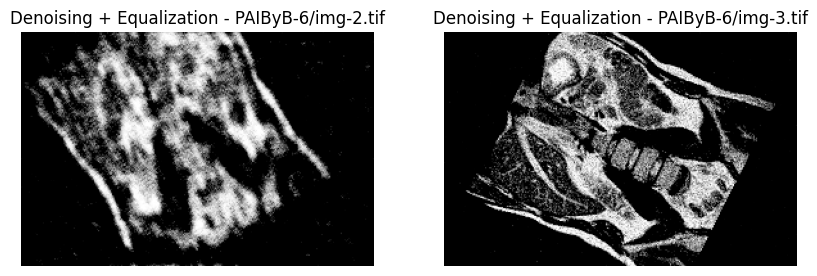

In [20]:
filtered_n_equ_imgs = np.array([cv2.equalizeHist(img) for img in filtered_imgs])
output_denoise = 'denoised_7' 
fig = plt.figure(figsize=(10,7))
for i, img, name in zip(range(1,3),filtered_n_equ_imgs,values_paibyb6_group1[1:]): 
    cv2.imwrite(f"{output_denoise}/{name.split('/')[-1]}", img) 
    print(f"{output_denoise}/{name.split('/')[-1]}")
    ax = fig.add_subplot(2,2,i)
    ax.imshow(img,cmap='gray')
    ax.axis('off')
    ax.set_title(f'Denoising + Equalization - {name}')

plt.show()

#### Segundo procesamiento

Para las imágenes del grupo 2, se utilizará la técnica de enhancing de contraste a través de una serie de aplicaciones de blurring de imágenes que se restan a la imagen original blurreada.

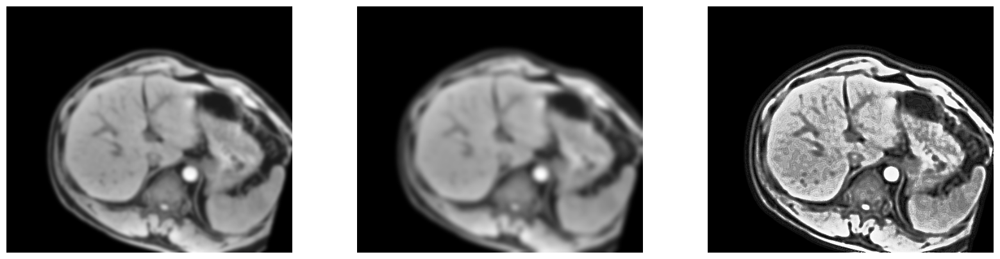

In [21]:
blur_img = cv2.blur(imgs_paibyb6_group2[1],(11,11))
img_diff = cv2.absdiff(imgs_paibyb6_group2[1],np.uint8(0.6*blur_img))
img_diff2 = cv2.absdiff(img_diff,np.uint8(0.7*cv2.blur(img_diff,(5,5))))
img_equ = cv2.equalizeHist(img_diff2)
img_diff3 = cv2.absdiff(img_equ,np.uint8(0.5*cv2.blur(img_equ,(5,5))))
img_equ2 = cv2.equalizeHist(img_diff3)

fig = plt.figure(figsize=(20,5))
ax = fig.add_subplot(1,3,1)
ax.imshow(imgs_paibyb6_group2[1],cmap='gray')
ax.axis('off')
ax = fig.add_subplot(1,3,2)
ax.imshow(blur_img,cmap='gray')
ax.axis('off')
ax = fig.add_subplot(1,3,3)
ax.imshow(img_equ2,cmap='gray')
ax.axis('off')

plt.show()

imgs_paibyb6_group2_1_filtered = img_equ2

### Nueva registración de las imágenes de 'PAIByB-6' luego del procesamiento

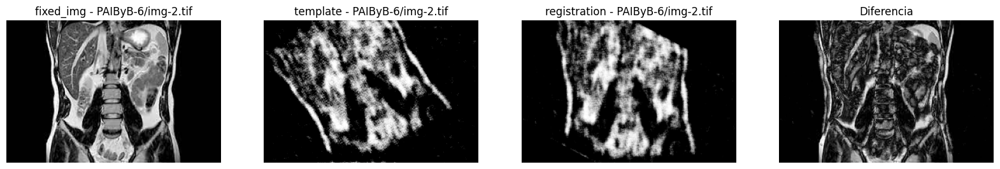

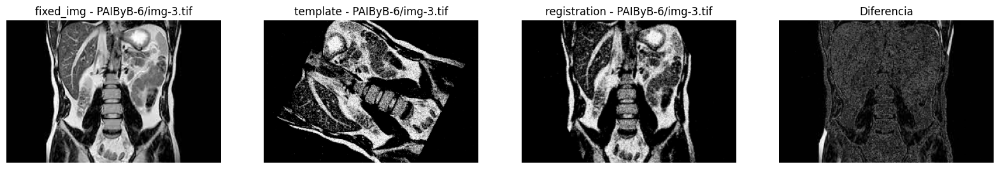

In [22]:
reg0, data0 = matchImg(fixed_img_6g1,filtered_n_equ_imgs[0],mode=2,counterclockwise=False)
reg1, data1 = matchImg(fixed_img_6g1,filtered_n_equ_imgs[1],mode=2,counterclockwise=False)

plotMatchComparison(fixed_img_6g1,filtered_n_equ_imgs[0],reg0,fixed_img_name=values_paibyb6_group1[1],template_name=values_paibyb6_group1[1])
plotMatchComparison(fixed_img_6g1,filtered_n_equ_imgs[1],reg1,fixed_img_name=values_paibyb6_group1[2],template_name=values_paibyb6_group1[2])

registration_imgs_6g1_filtered = [reg0,reg1]

La registración fue un éxito.

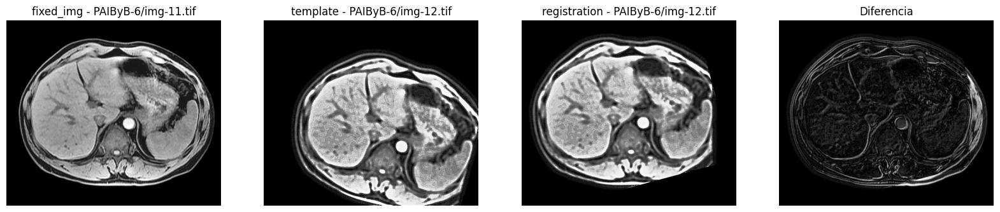

[np.int64(15), np.float64(0.9470717310905457)]


In [23]:
reg3, data3 = matchImg(fixed_img_6g2,imgs_paibyb6_group2_1_filtered,mode=1)

plotMatchComparison(fixed_img_6g2,imgs_paibyb6_group2_1_filtered,reg3,fixed_img_name=values_paibyb6_group2[0],template_name=values_paibyb6_group2[1])
print(data3)

registration_imgs_6g2_filtered = [reg3]

La registración fue un éxito.

### Métricas

In [24]:
m0 = getMetrics4Group(fixed_img_5g1,registration_imgs_5g1,values_paibyb5_group1[1:])
m1 = getMetrics4Group(fixed_img_5g2,registration_imgs_5g2,values_paibyb5_group2[1:])
m2 = getMetrics4Group(fixed_img_6g1,registration_imgs_6g1,values_paibyb6_group1[1:])
m3 = getMetrics4Group(fixed_img_6g2,registration_imgs_6g2,values_paibyb6_group2[1:])

frames = [m0,m1,m2,m3]

pd.concat(frames)

,PSNR,SSIM
PAIByB-5/img-2.tif,73.934207,0.859251
PAIByB-5/img-3.tif,103.720405,0.978171
PAIByB-5/img-4.tif,79.607940,0.866218
PAIByB-5/img-12.tif,73.960066,0.622219
PAIByB-6/img-2.tif,65.763023,0.111354
PAIByB-6/img-3.tif,64.951935,0.067827
PAIByB-6/img-12.tif,72.012824,0.646738


Se puede apreciar que, para la registración de las imágenes sin previo procesamiento, las mediciones de similitud es mayor al 60% (SSIM) para todos los casos excepto en el grupo 1 de imágenes de la carpeta 'PAIByB-6'. En estos dos casos, no solo influye la registración sino también la calidad de las imágenes.

In [25]:
m4 = getMetrics4Group(fixed_img_6g1,registration_imgs_6g1_filtered,values_paibyb6_group1[1:])
m5 = getMetrics4Group(fixed_img_6g2,registration_imgs_6g2_filtered,values_paibyb6_group2[1:])

frames = [m4,m5]

pd.concat(frames)

,PSNR,SSIM
PAIByB-6/img-2.tif,69.428214,0.328498
PAIByB-6/img-3.tif,70.205894,0.699601
PAIByB-6/img-12.tif,69.206228,0.558159


Se puede apreciar que, para le registración de las imágenes con previo procesamiento, las mediciones de similitud es mayor con respecto al caso sin previo procesamiento pero en ningún caso se llega al 60% de similitud. Esto no se debe a la registración, ya que el proceso fue exitoso en todos los casos, sino al hecho de que los objetos de las imágenes procesadas son particuarlmente diferentes a los objetos de la imágen fija.

### Conclusiones

La registración basada en CCN es muy efectiva para los casos en donde solo sea necesario aplicar técnicas de traslación y rotación. No se han estudiado casos donde sea necesario una transformación no rígida. Por otro lado, el tipo de ruido en las imágenes influye en el resultado de la aplicación de CCN: algunos tipos de ruido no afectan a la registración, como el caso de 'img-2' de la carpeta 'PAIByB-6'; otros tipos de ruido, como el 'img-3' de la carpeta 'PAIByB-6' sí afectó la registración.

Se puede decir que un paso previo para preprocesar las imágenes sí ayuda en la registración pero otro procedimiento en la registración es ligeramente diferentes: en estos casos, registrar la imágen entera no era efectivo, entonces se tomó como referencia la registración de secciones pequeñas de las imágenes con tal de tomar registro de los movimientos de rotación y traslación de esa parte pequeña y aplicarlos a la imagen original.

Los resultados fueron un éxito, tal como lo indican las métricas.

# Ejercicio 3
3- Realice una registración basada en características de la imágenes contenidas en “PAIByB-5”
utilizando detectores de Harris como puntos a emparejar, evaluando los resultados con las métricas
de la GUIA I ¿Qué conclusiones puede sacar al respecto? Comparar los resultados con los ejercicios
anteriores.

In [2]:
%load_ext autoreload
%autoreload 2

In [1]:
from registration import Imagen, Registracion
from reg_toolkit import lista_de_paths, agrupar_paths
from reg_toolkit import peak_SNR, getPathfiles

In [6]:
base_dir = 'PAIByB-5'
#extrigo paths 
lista_paths = list(getPathfiles(base_dir).values())
# Agrupar los paths
un_digito, dos_digitos = agrupar_paths(lista_paths)
#aplico la clase Imagen, esta me lee la imagen y calcula los puntos calve 
un_digito_imgs = [Imagen(image, feature_extractor='harris', harris_thres=0.01) for image in un_digito ]
dos_digito_imgs = [Imagen(image, feature_extractor='harris', harris_thres=0.01) for image in dos_digitos ]


________________________________________________________________________________
Imagen PAIByB-5/img-2


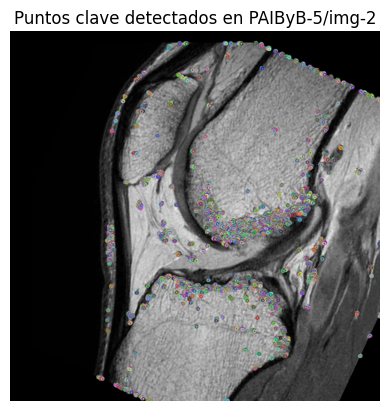

Matches encontrados: 478


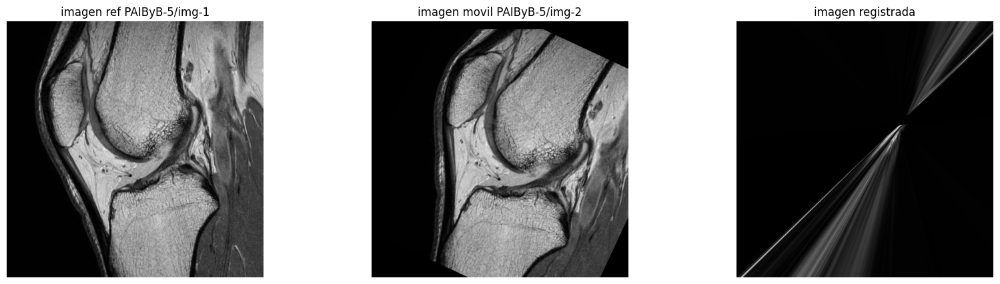

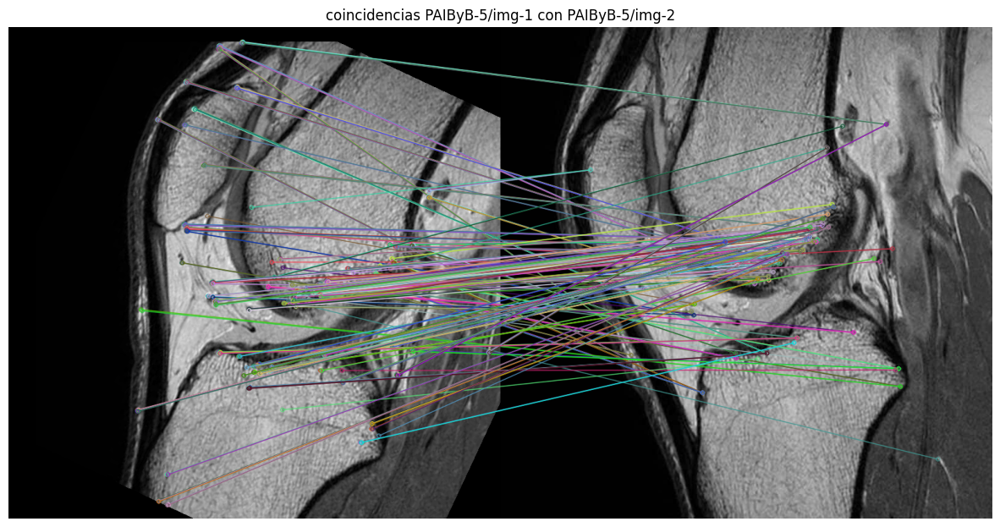

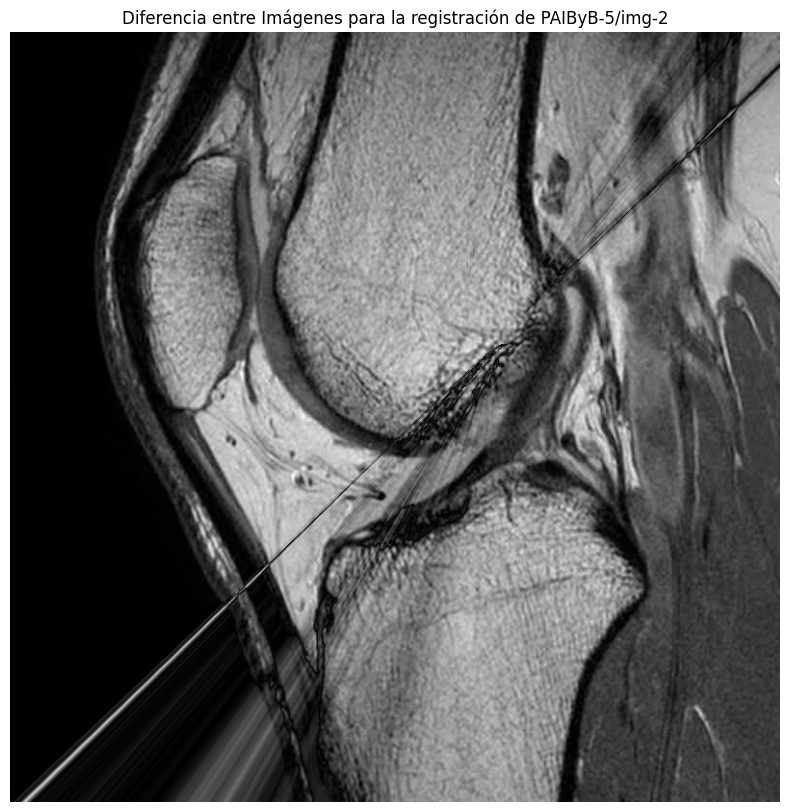

SSIM: 0.1806
MSE: 86.7198
PSNR: 66.1984

________________________________________________________________________________
Imagen PAIByB-5/img-3


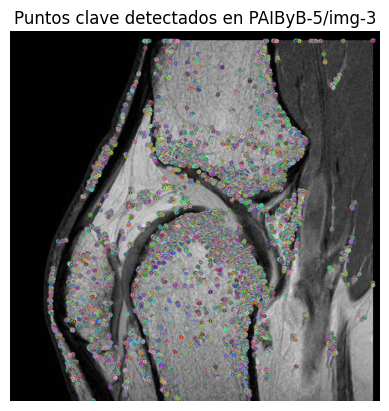

Matches encontrados: 1641


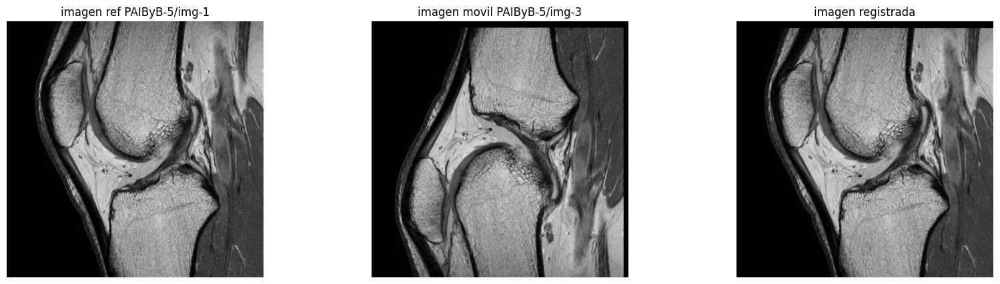

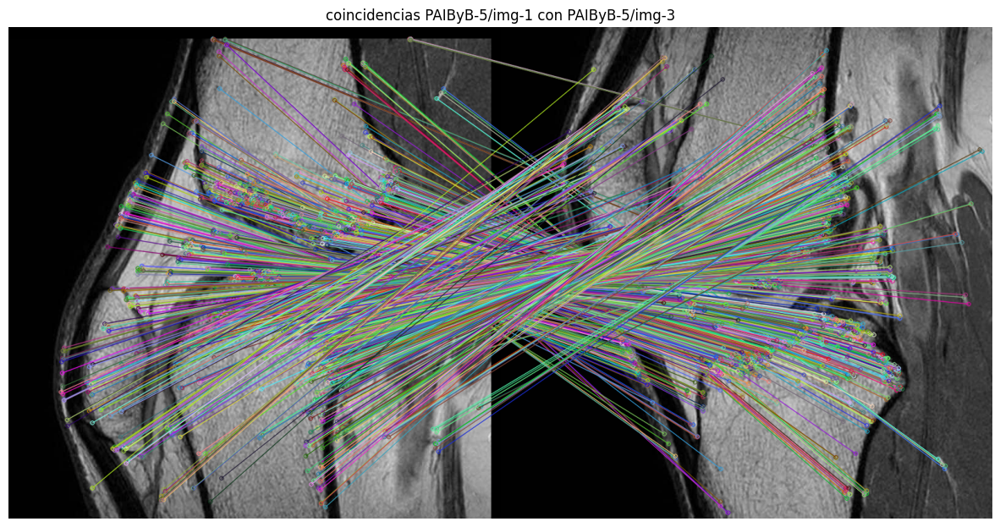

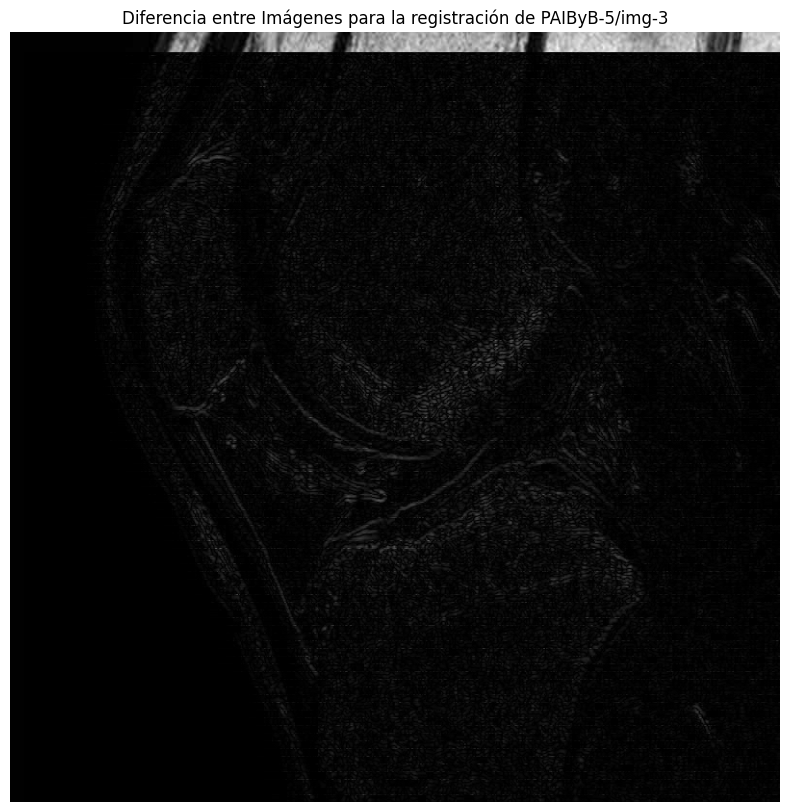

SSIM: 0.9063
MSE: 24.4468
PSNR: 78.8603

________________________________________________________________________________
Imagen PAIByB-5/img-4


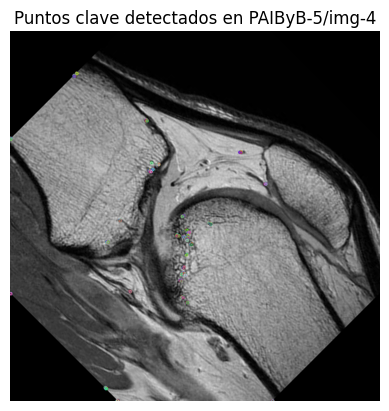

Matches encontrados: 15
Error en la imagen PAIByB-5/img-4
La homografía no ha sido calculada.


In [8]:
img_ref = un_digito_imgs[0]
for img in un_digito_imgs[1:]:
    try:
        print('\n'+80*'_')
        print(f'Imagen {img.nombre}')
        img.mostrar_puntos_clave()
        # Crea una instancia de Registracion utilizando Harris como descriptor
        prueba = Registracion(imagen_referencia=img_ref,
                              imagen_movil=img,
                              lowe_threshold=0.3,
                              min_match_count=4)
        prueba.ejecutar_registracion()
    except Exception as e:
        print(f'Error en la imagen {img.nombre}')
        print(e)
        continue

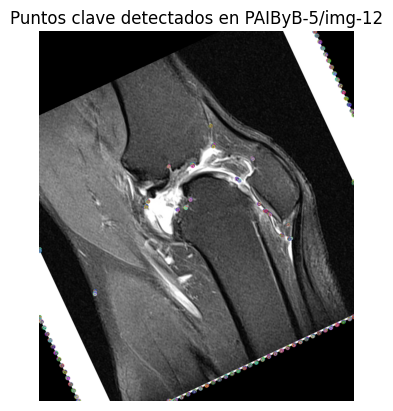

In [9]:
dos_dig_ref = dos_digito_imgs[0]
dos_dig_img = dos_digito_imgs[1]

dos_dig_img.mostrar_puntos_clave()

In [10]:
for img in dos_digito_imgs[1:]:
    try:
        print('\n'+80*'_')
        print(f'Imagen {img.nombre}')
        # Crea una instancia de Registracion utilizando Harris como descriptor
        prueba = Registracion(imagen_referencia=dos_digito_imgs[0],
                              imagen_movil=img,
                              lowe_threshold=1,
                              ransac_thres=0,
                              min_match_count=4)
        prueba.ejecutar_registracion()
    except Exception as e:
        print(f'Error en la imagen {img.nombre}')
        print(e)
        continue


________________________________________________________________________________
Imagen PAIByB-5/img-12
Matches encontrados: 40
Error en la imagen PAIByB-5/img-12
La homografía no ha sido calculada.


### Conclusiones
En general, la registración basada en características de las imágenes contenidas en “PAIByB-5” utilizando detectores de Harris como puntos a emparejar, no resultó ser efectiva. En la mayoría de los casos, la registración no se pudo llevar a cabo. En los casos en los que se logró, la registración no resultó ser efectiva, ya que no se logró un buen alineamiento entre las imágenes.
Solo en el caso de la imagen rotada se consiguieron resultados aceptables, pero no se logró un alineamiento perfecto en ninguno de los otros casos.

Los motivos podrían ser:
- La baja cantidad de puntos clave detectados por el detector de Harris.
- La detección de falsos puntos clave en los bordes de las imágenes.

# Ejercicio 4
4- Realice una registración basada en características, otra con CCN y otra con MI de la imágenes
contenidas en “PAIByB-7”, evaluando los resultados con las métricas de la GUIA I ¿Qué
conclusiones puede sacar al respecto? Comparar los resultados entre sí.

In [9]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from registration import Imagen, Registracion

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


Antes de comenzar, se aclara que se utilizaran las versiones denoiseadas de las imágenes, ya que se obtienen mejores resultados en la registración.

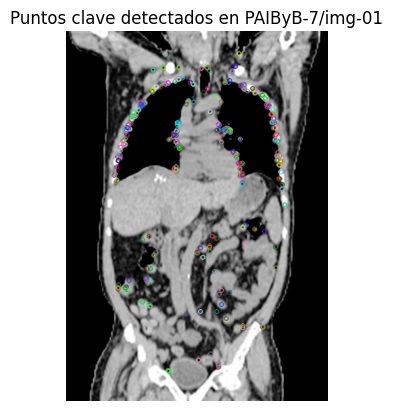

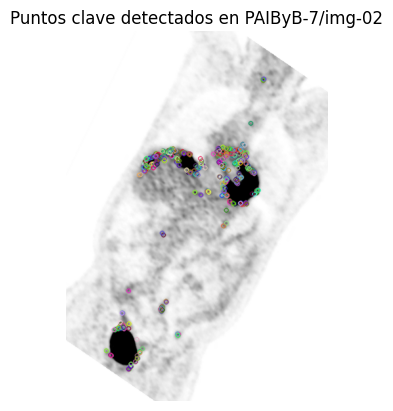

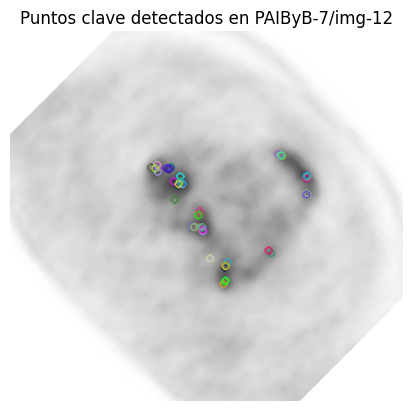

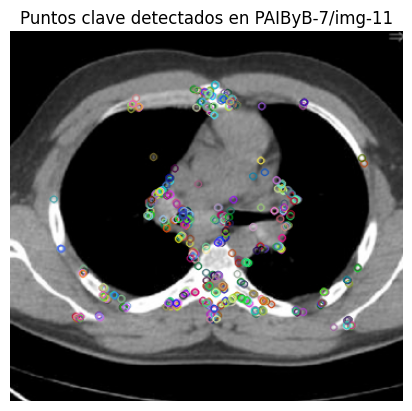

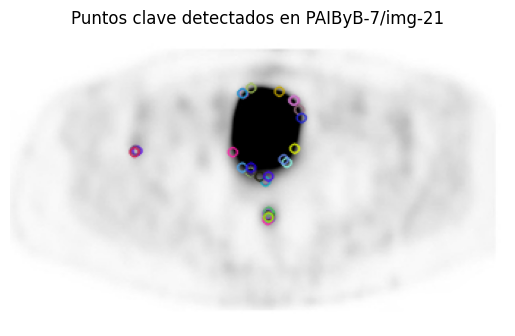

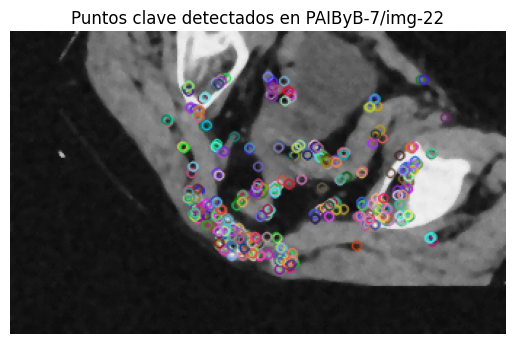

In [45]:
base_dir = 'PAIByB-7'
reg_pairs = {f"{base_dir}/img-{i}{i%2+1}.tif": f"{base_dir}/img-{i}{(i+1)%2+1}.tif" for i in range(3)}
img_obj_pairs = []

for img1, img2 in reg_pairs.items():
    im1 = Imagen(img1, feature_extractor='orb')
    im1.mostrar_puntos_clave()
    im2 = Imagen(img2, feature_extractor='sift')
    # Invertimos la imagen y recalculamos los puntos clave
    #im2.imagen = 255 - im2.imagen
    #im2.extraer_puntos_clave()
    im2.mostrar_puntos_clave()
    img_obj_pairs.append((im1, im2))

# Registración basada en características por SIFT

In [34]:
img_raw_pairs = [(im1.imagen, im2.imagen) for im1, im2 in img_obj_pairs]

def processImg(img):
    img_invert = np.uint8(255*np.ones(np.shape(img))-0.7*img)
    img_resta = cv2.absdiff(img,np.uint8(1.6*img_invert))
    img_invert = np.uint8(255*np.ones(np.shape(img_resta))-0.7*img_resta)
    
    return img_invert

img_raw_pairs[0] = (img_raw_pairs[0][0], processImg(img_raw_pairs[0][1]))
img_raw_pairs[1] = (processImg(img_raw_pairs[1][0]), img_raw_pairs[1][1])
img_raw_pairs[2] = (processImg(img_raw_pairs[2][0]), img_raw_pairs[2][1])

Matches encontrados: 10


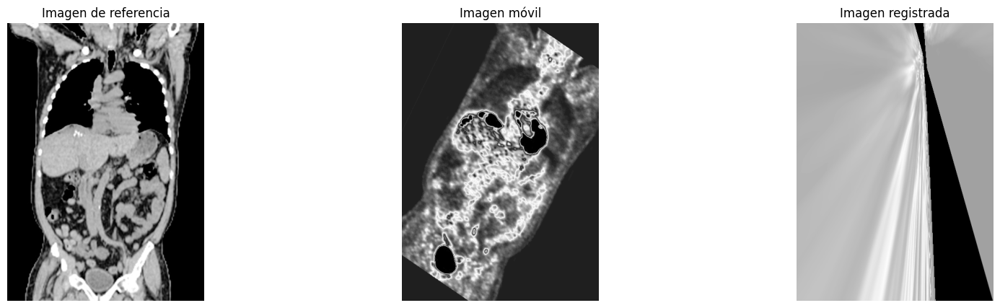

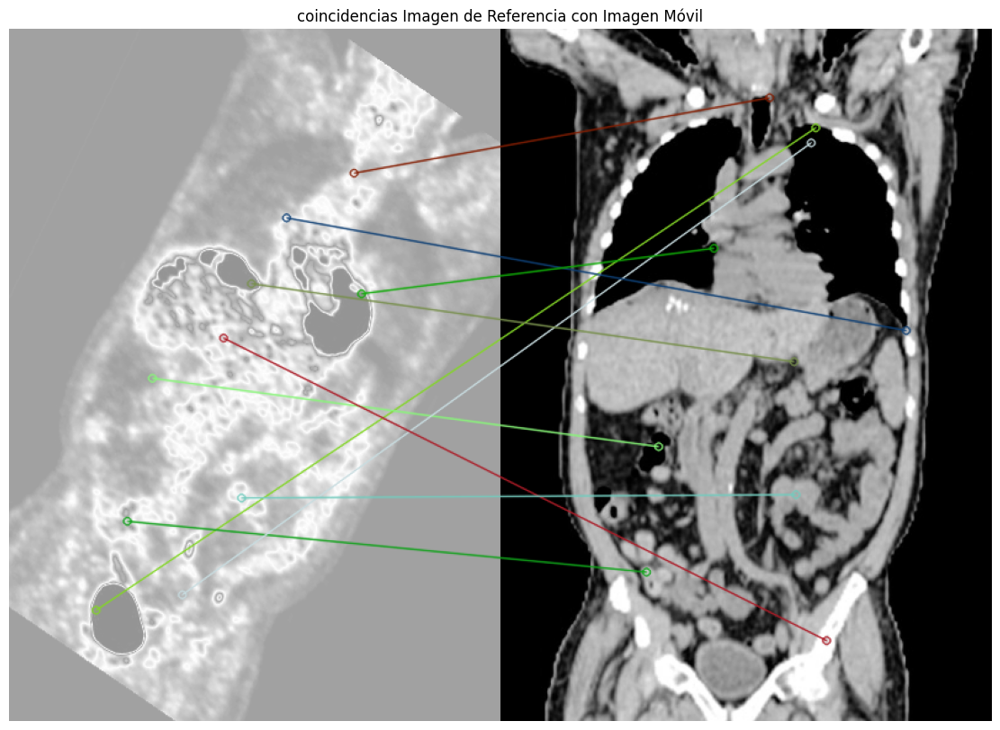

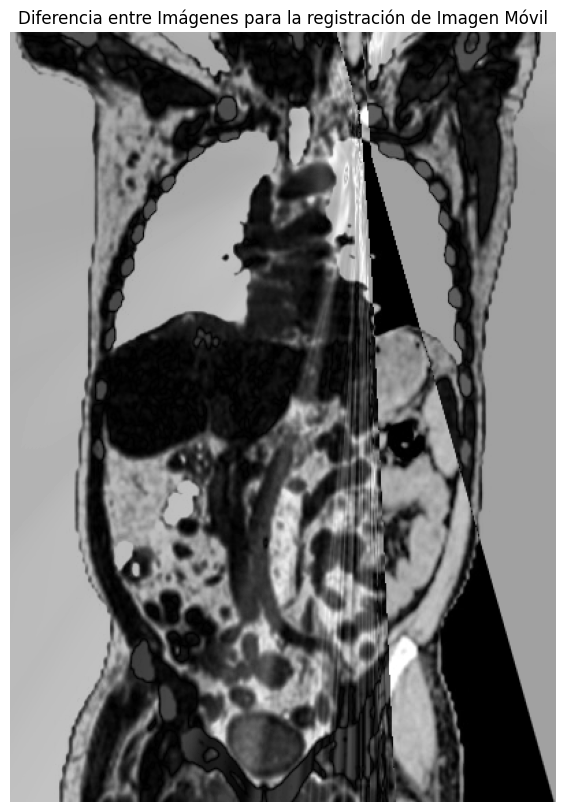

SSIM: 0.1572
MSE: 95.7204
PSNR: 65.2110
SSIM: 0.1572
MSE: 95.7204
PSNR: 65.2110
Matches encontrados: 20


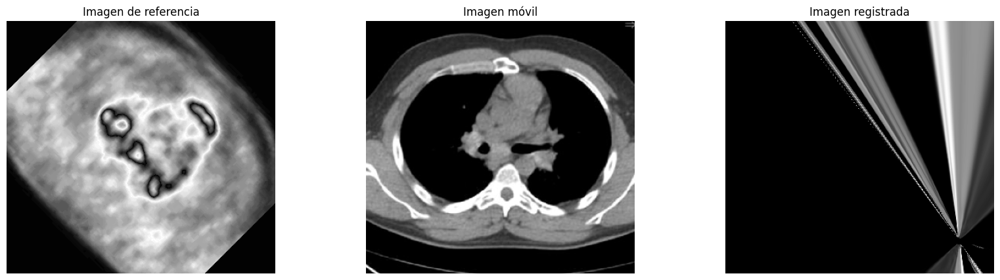

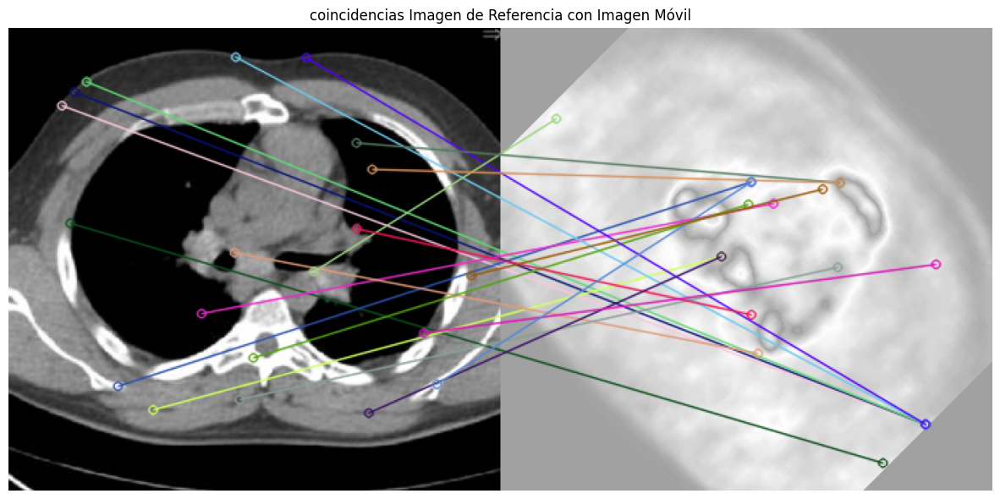

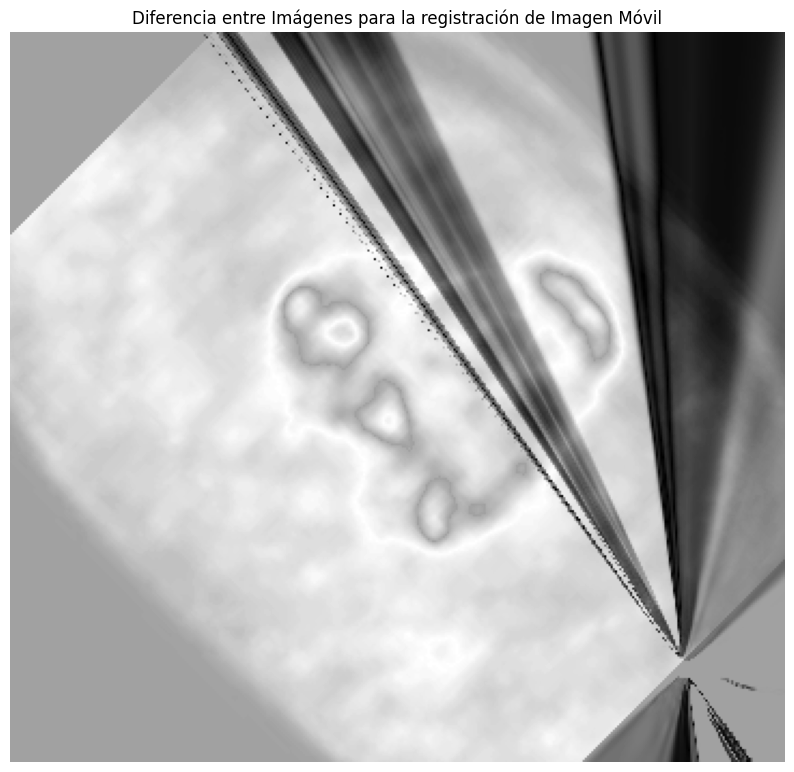

SSIM: 0.0843
MSE: 106.6326
PSNR: 64.1314
SSIM: 0.0843
MSE: 106.6326
PSNR: 64.1314
Matches encontrados: 18


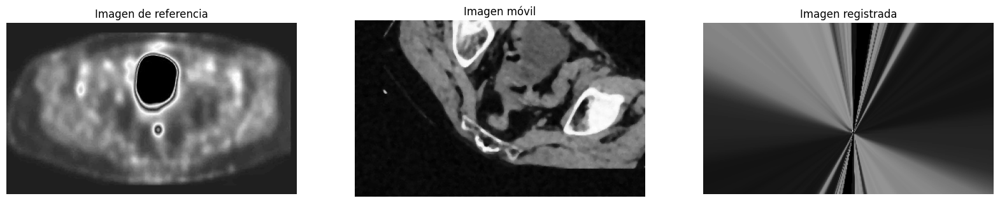

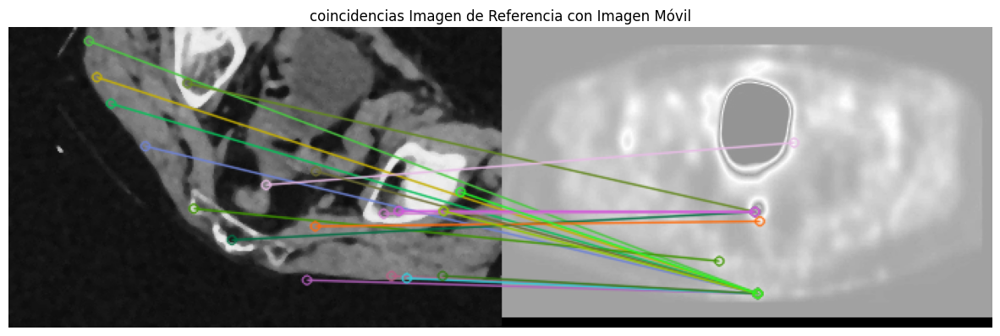

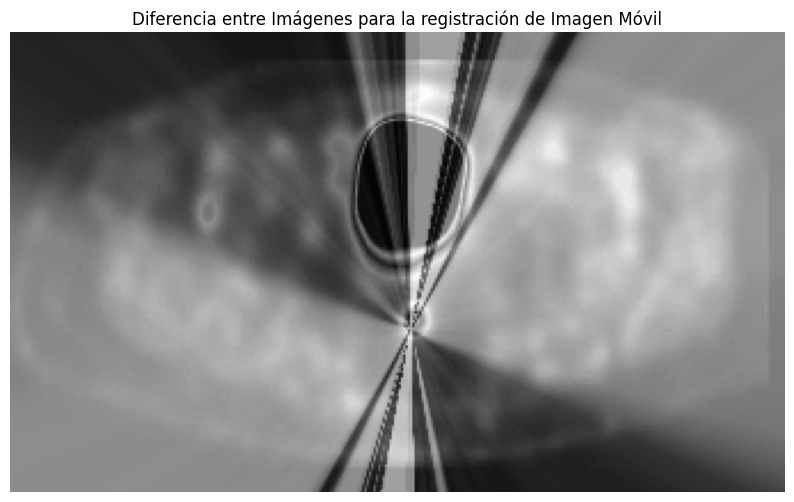

SSIM: 0.3176
MSE: 118.8192
PSNR: 63.0492
SSIM: 0.3176
MSE: 118.8192
PSNR: 63.0492


In [51]:
# Registración basada en características
for i, tup in enumerate(img_raw_pairs):
    reg = Registracion(tup[0], tup[1], modo='features', min_match_count=4, lowe_threshold=0.8, ransac_thres=5)
    reg.ejecutar_registracion(plot=True)
    reg.calcular_metricas()

## Registración basada en CCN


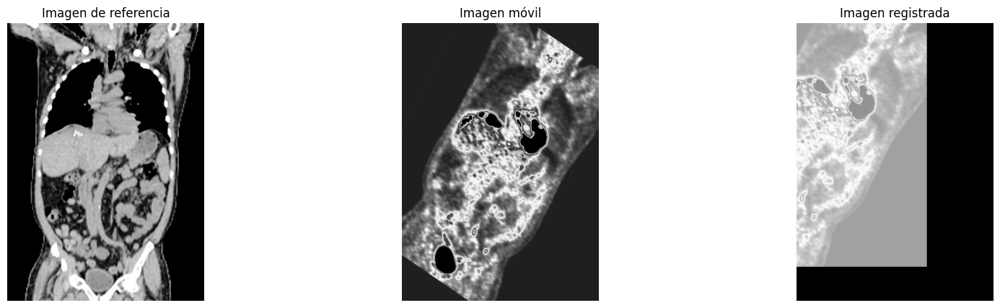

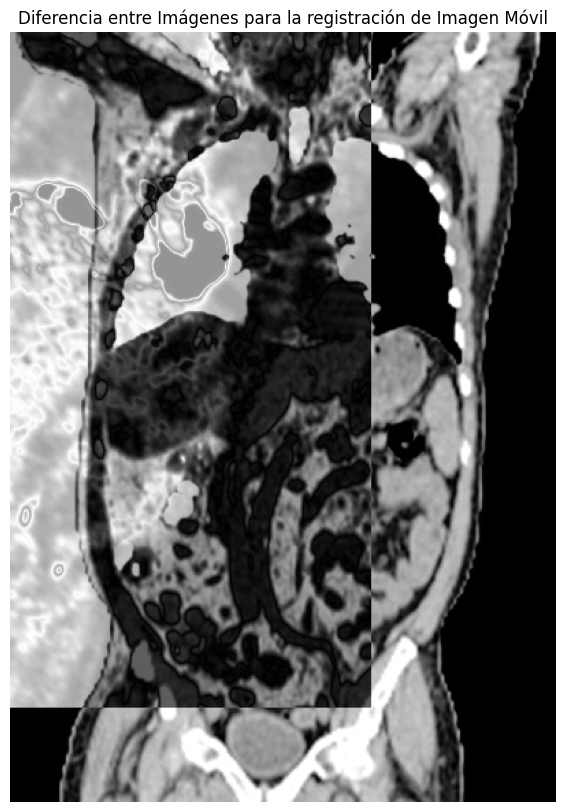

SSIM: 0.2290
MSE: 87.4237
PSNR: 66.1176


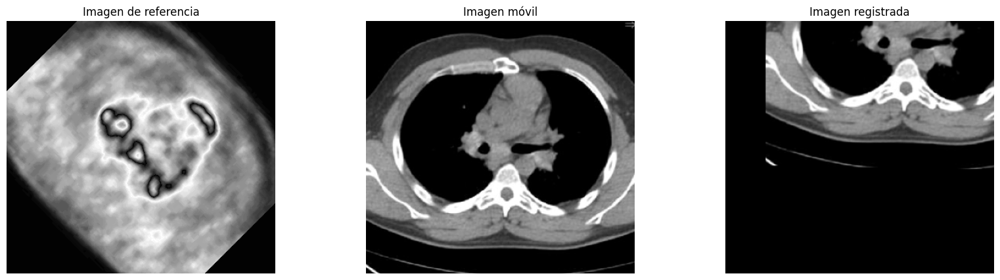

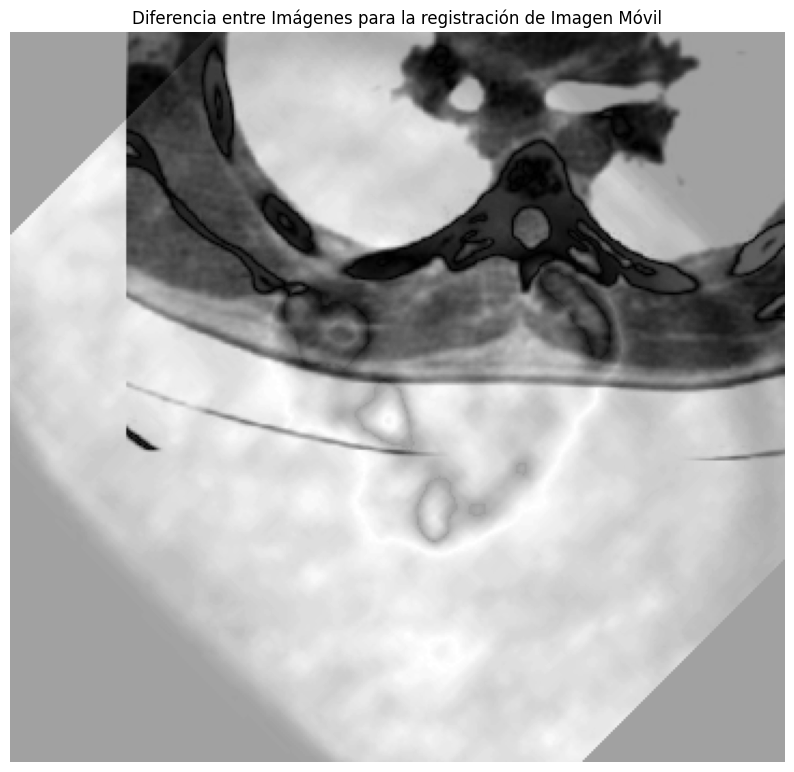

SSIM: 0.0658
MSE: 106.0824
PSNR: 64.1831


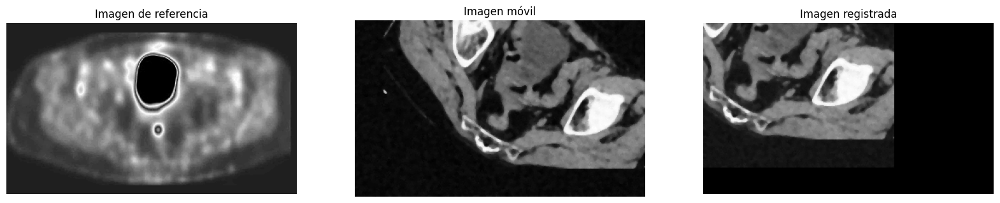

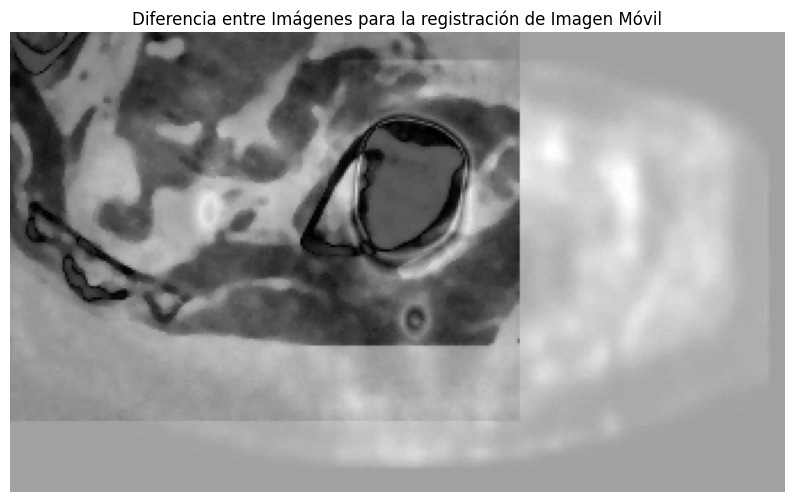

SSIM: 0.1059
MSE: 111.6143
PSNR: 63.6748


In [52]:
for im1, im2 in img_raw_pairs:
    reg = Registracion(im1, im2, modo='intensidad')
    reg.registracion_CCN()
    reg.plot_registracion()
    reg.calcular_metricas()

## Registración basada en MI

Información Mutua inicial: 0.128886
differential_evolution step 1: f(x)= -0.20656224501836387
differential_evolution step 2: f(x)= -0.25404535677142265
differential_evolution step 3: f(x)= -0.25404535677142265
differential_evolution step 4: f(x)= -0.25404535677142265
differential_evolution step 5: f(x)= -0.25404535677142265
differential_evolution step 6: f(x)= -0.25404535677142265
differential_evolution step 7: f(x)= -0.2707185835413964
differential_evolution step 8: f(x)= -0.2707185835413964
differential_evolution step 9: f(x)= -0.2749613140539774
differential_evolution step 10: f(x)= -0.2749613140539774
differential_evolution step 11: f(x)= -0.2749613140539774
differential_evolution step 12: f(x)= -0.27732364807814397
differential_evolution step 13: f(x)= -0.27732364807814397
differential_evolution step 14: f(x)= -0.2799859776410503
differential_evolution step 15: f(x)= -0.2799859776410503
differential_evolution step 16: f(x)= -0.28041477155896805
differential_evolution step 17: f(x)

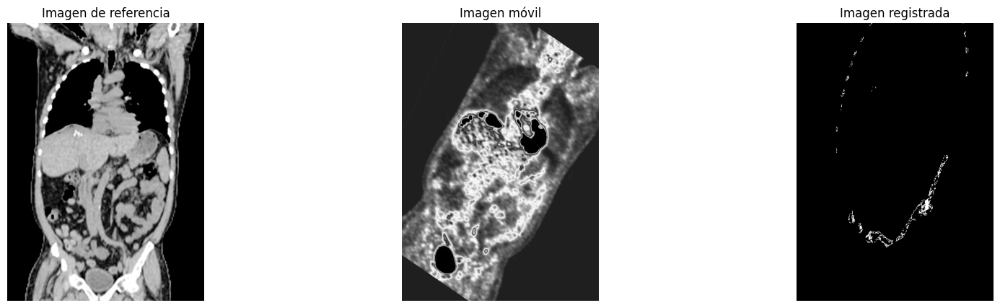

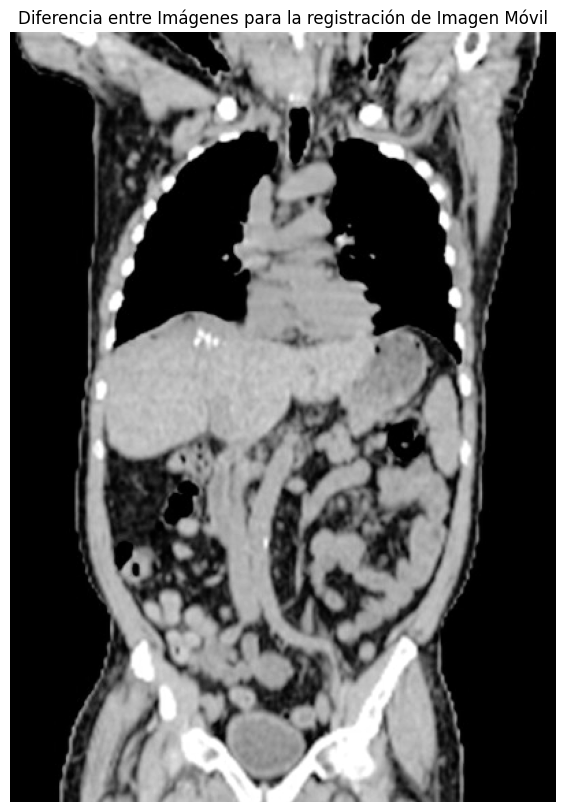

SSIM: 0.3041
MSE: 69.4775
PSNR: 68.4152
Información Mutua inicial: 0.200812
differential_evolution step 1: f(x)= -0.21588709588660074
differential_evolution step 2: f(x)= -0.22402974257758615
differential_evolution step 3: f(x)= -0.22402974257758615
differential_evolution step 4: f(x)= -0.24983280324288043
differential_evolution step 5: f(x)= -0.24983280324288043
differential_evolution step 6: f(x)= -0.2810581988441349
differential_evolution step 7: f(x)= -0.29459312929179515
differential_evolution step 8: f(x)= -0.29459312929179515
differential_evolution step 9: f(x)= -0.29459312929179515
differential_evolution step 10: f(x)= -0.29459312929179515
differential_evolution step 11: f(x)= -0.29459312929179515
differential_evolution step 12: f(x)= -0.29459312929179515
differential_evolution step 13: f(x)= -0.29459312929179515
differential_evolution step 14: f(x)= -0.29459312929179515
differential_evolution step 15: f(x)= -0.29459312929179515
differential_evolution step 16: f(x)= -0.29934792

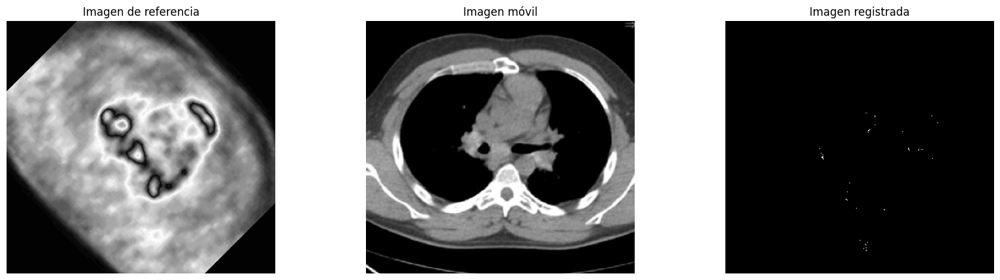

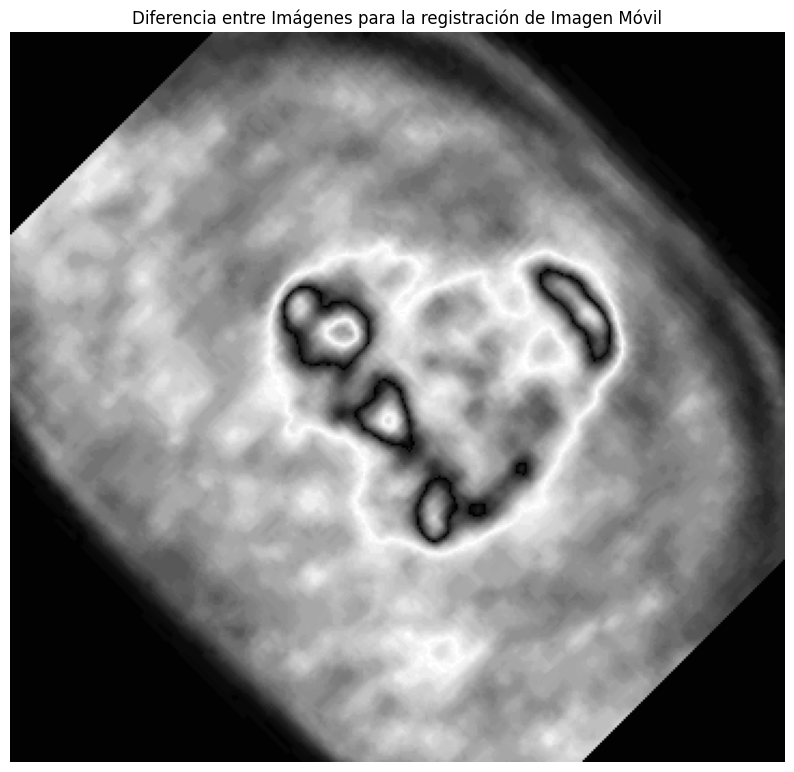

SSIM: 0.0001
MSE: 106.3812
PSNR: 64.1550
Información Mutua inicial: 0.432847
differential_evolution step 1: f(x)= -0.6184335766218371
differential_evolution step 2: f(x)= -0.6184335766218371
differential_evolution step 3: f(x)= -0.6184335766218371
differential_evolution step 4: f(x)= -0.6387394500553185
differential_evolution step 5: f(x)= -0.6387394500553185
differential_evolution step 6: f(x)= -0.6761488698118377
differential_evolution step 7: f(x)= -0.6761488698118377
differential_evolution step 8: f(x)= -0.6761488698118377
differential_evolution step 9: f(x)= -0.6847404829028978
differential_evolution step 10: f(x)= -0.6984819528274538
differential_evolution step 11: f(x)= -0.6984819528274538
differential_evolution step 12: f(x)= -0.6998253213168234
differential_evolution step 13: f(x)= -0.6998253213168234
differential_evolution step 14: f(x)= -0.7010015247159307
differential_evolution step 15: f(x)= -0.7010015247159307
differential_evolution step 16: f(x)= -0.7095130893617458
diff

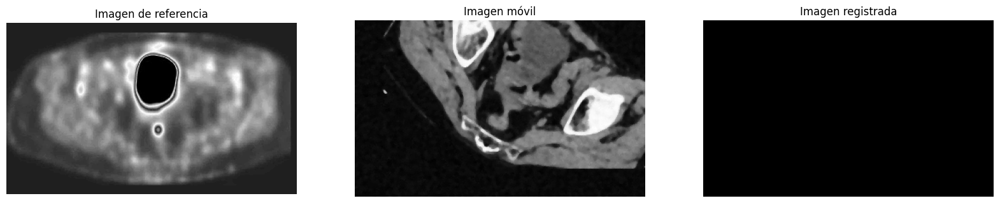

OpenCV(4.10.0) /io/opencv/modules/core/src/arithm.cpp:658: error: (-209:Sizes of input arguments do not match) The operation is neither 'array op array' (where arrays have the same size and the same number of channels), nor 'array op scalar', nor 'scalar op array' in function 'arithm_op'



<Figure size 1000x1000 with 0 Axes>

In [37]:
for im1, im2 in img_raw_pairs:
    try:
        reg = Registracion(im1, im2, modo='intensidad')
        reg.registracion_IM()
        reg.plot_registracion()
        reg.calcular_metricas()
    except Exception as e:
        print(e)
        continue

## Conclusiones

A pesar de mis mayores intentos, no hubo manera de registrar adecuadamente ninguna imagen con ninguno de los métodos sugeridos. Evidentemente, el trabajo previo de reducción de ruido no fue suficiente.